<a href="https://colab.research.google.com/github/Ariepramudya01/Classification-Clustering-of-Mature-Papaya/blob/main/Clustering_Mature_For_Papaya_Combine_CNN_%26_K_Medoids.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# prompt: tolong hapus seluruh output file gambar dihapus

!rm -rf *.jpg


In [ ]:
# prompt: kemudian download sklearn K-medoids. jika sudah ada jangan dieksekusi

!pip install scikit-learn-extra


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 19.4 MB/s eta 0:00:00


In [ ]:
import os
import pandas as pd
from PIL import Image, ImageFilter
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import zipfile
import random
import seaborn as sns
import warnings
import shutil
import cv2
import time
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import Callback
from google.colab import files
from google.colab import drive
from sklearn.preprocessing import StandardScaler, label_binarize
from sklearn.metrics import confusion_matrix, classification_report, precision_recall_fscore_support, roc_curve, auc
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Dense, Dropout, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import load_model
warnings.filterwarnings('ignore')

In [ ]:
# prompt: mount ke google drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Create the destination directory if it doesn't exist

os.makedirs('/root/.kaggle/', exist_ok=True)

# Now copy the file
shutil.copy('/content/drive/MyDrive/Klasifikasi Pepaya/kaggle.json', '/root/.kaggle/kaggle.json')

'/root/.kaggle/kaggle.json'

In [ ]:
!kaggle datasets download -d nurhafiizah/papaya-datasets

Dataset URL: https://www.kaggle.com/datasets/nurhafiizah/papaya-datasets
License(s): MIT
 97% 154M/158M [00:03<00:00, 55.7MB/s]
100% 158M/158M [00:03<00:00, 42.2MB/s]


In [ ]:
# prompt: ekstrak filezip dan buat foldernya

# Extract the zip file
zip_ref = zipfile.ZipFile('/content/papaya-datasets.zip', 'r')
zip_ref.extractall('/content/papaya-datasets')
zip_ref.close()


In [ ]:
# Set basepath
basepath = "/content/papaya-datasets/Citra Papaya/papaya_image"

In [ ]:
def hitung_gambar_dalam_direktori(direktori):
    """
    Fungsi ini akan menghitung jumlah gambar dalam direktori yang diberikan.

    Args:
        direktori (str): Path ke direktori yang berisi gambar.

    Returns:
        int: Jumlah gambar yang ditemukan.
    """

    jumlah_gambar = 0
    for root, _, files in os.walk(direktori):
        for file in files:
            if file.endswith(('.jpg', '.jpeg', '.png', '.bmp')):
                jumlah_gambar += 1

    return jumlah_gambar

# Contoh penggunaan
total_gambar = hitung_gambar_dalam_direktori(basepath)
print("Jumlah gambar dalam direktori:", total_gambar)

Jumlah gambar dalam direktori: 500


In [ ]:
# Membuat list untuk menyimpan data
data = []

# Menentukan nilai target untuk setiap kategori dan mengganti nama kategori
category_dict = {
    'unmature': 'mentah',
    'partiallymature': 'mengkal',
    'mature': 'matang'
}

target_dict = {
    'mentah': 0,
    'mengkal': 1,
    'matang': 2
}

# Loop melalui setiap folder dalam main_folder
for original_category in category_dict.keys():
    category_path = os.path.join(basepath, original_category)
    if os.path.exists(category_path):  # Memeriksa apakah folder ada
        for file_name in os.listdir(category_path):
            file_path = os.path.join(category_path, file_name)
            category = category_dict[original_category]
            # Menambahkan informasi file ke dalam list data
            data.append({
                'filename': file_name,
                'category': category,
                'target': target_dict[category],
                'filepath': file_path
            })

# Membuat dataframe dari data
df = pd.DataFrame(data)

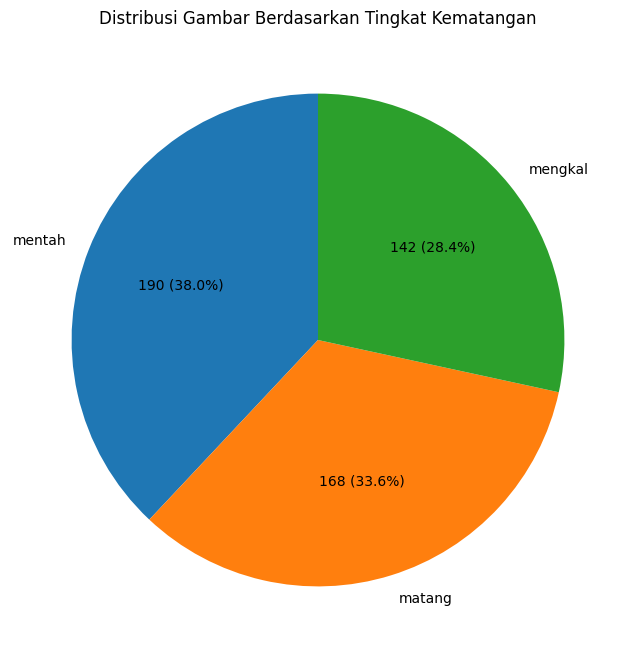

In [ ]:
# Asumsikan Anda sudah memiliki DataFrame 'df' dengan kolom 'category'

# Hitung jumlah gambar per kategori
data = df['category'].value_counts()

# Buat pie chart
plt.figure(figsize=(8, 8))
plt.pie(data, labels=data.index, autopct=lambda p: '{:.0f} ({:.1f}%)'.format(p*sum(data)/100, p), startangle=90)
plt.title('Distribusi Gambar Berdasarkan Tingkat Kematangan')
plt.show()

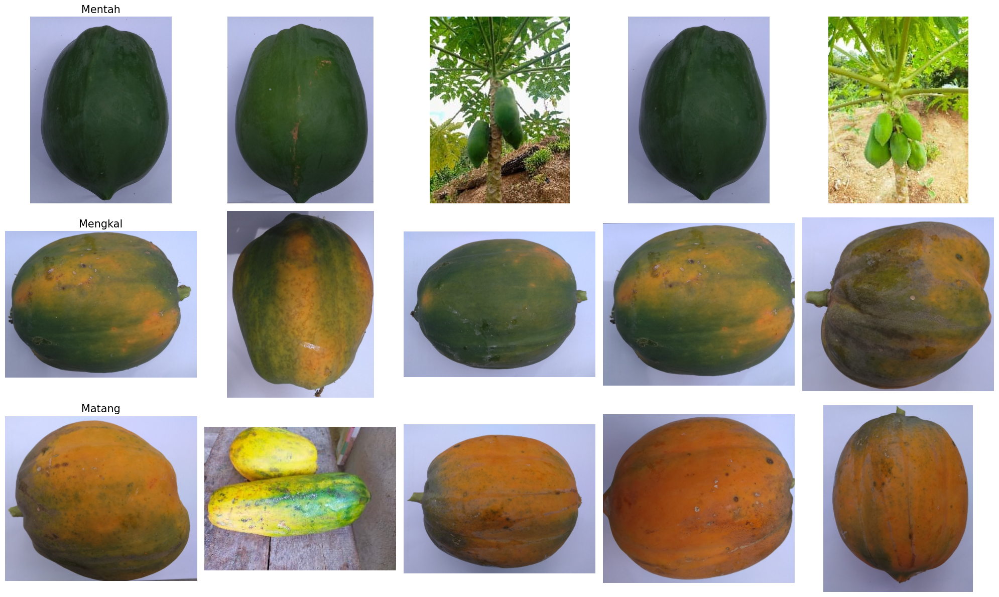

In [ ]:
# Menampilkan 5 gambar berdasarkan masing-masing tingkat kematangan
fig, axes = plt.subplots(3, 5, figsize=(20, 12))

for i, category in enumerate(['mentah', 'mengkal', 'matang']):
    # Mengambil 5 gambar pertama dari kategori ini
    subset = df[df['category'] == category].head(5)
    for j, (index, row) in enumerate(subset.iterrows()):
        img = Image.open(row['filepath'])
        axes[i, j].imshow(img)
        axes[i, j].axis('off')
        if j == 0:
            axes[i, j].set_title(category.capitalize(), size=15)

plt.tight_layout()
plt.show()

In [ ]:
# prompt: Saya ingin melakukan preprocessing data berdasarkan fitur warna. supaya gambarnya sama rata tolong dicrop tanpa memotong objek. dan kasih tau jika processing datanya sudah selesai

def preprocess_image(image_path):
  # Buka gambar
  img = Image.open(image_path)

  # Tentukan ukuran crop yang sesuai (misalnya, 80% dari ukuran asli)
  crop_width = int(img.width * 0.8)
  crop_height = int(img.height * 0.8)

  # Tentukan koordinat tengah gambar
  center_x = img.width // 2
  center_y = img.height // 2

  # Hitung koordinat kiri atas dan kanan bawah untuk cropping
  left = center_x - crop_width // 2
  top = center_y - crop_height // 2
  right = center_x + crop_width // 2
  bottom = center_y + crop_height // 2

  # Crop gambar
  cropped_img = img.crop((left, top, right, bottom))

  # Ubah ukuran gambar ke ukuran yang diinginkan (misalnya, 224x224)
  resized_img = cropped_img.resize((224, 224))

  # Konversi gambar ke array numpy
  img_array = np.array(resized_img)

  return img_array

# Terapkan preprocessing ke semua gambar
preprocessed_images = []
preprocessed_labels = []

for index, row in df.iterrows():
  image_path = row['filepath']
  label = row['target']

  preprocessed_image = preprocess_image(image_path)

  preprocessed_images.append(preprocessed_image)
  preprocessed_labels.append(label)

# Konversi list ke array numpy
X = np.array(preprocessed_images)
y = np.array(preprocessed_labels)

print("Preprocessing data selesai.")


Preprocessing data selesai.


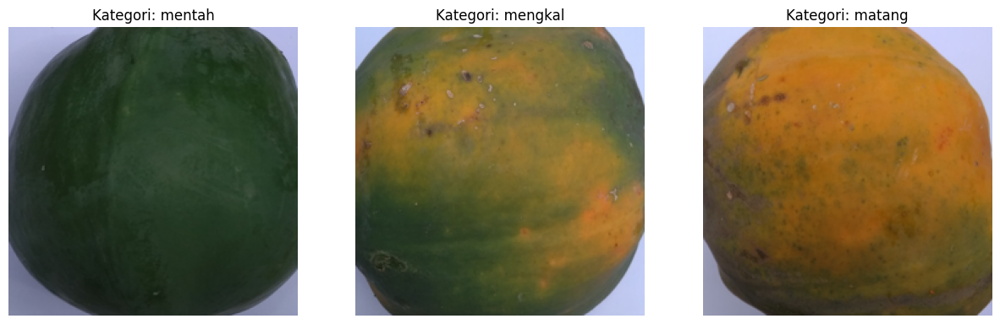

In [ ]:
# Menampilkan satu gambar per kelas
plt.figure(figsize=(15, 5))
for i, category in enumerate(['mentah', 'mengkal', 'matang']):
    # Mencari indeks gambar pertama dalam kategori ini
    index = df[df['category'] == category].index[0]

    # Menampilkan gambar
    plt.subplot(1, 3, i+1)
    plt.imshow(X[index])
    plt.title(f"Kategori: {category}")
    plt.axis('off')

plt.show()


In [ ]:
def extract_color_features(image):
  # Konversi ke ruang warna RGB
  rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  # Hitung rata-rata nilai RGB
  mean_rgb = np.mean(rgb_image, axis=(0, 1))

  # Konversi ke ruang warna HSV
  hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

  # Hitung rata-rata nilai HSV
  mean_hsv = np.mean(hsv_image, axis=(0, 1))

  # Gabungkan fitur warna RGB dan HSV
  color_features = np.concatenate((mean_rgb, mean_hsv))

  return color_features

# Inisialisasi list untuk menyimpan fitur warna
color_features_list = []

# Ekstrak fitur warna untuk setiap gambar
for image in X:
  color_features = extract_color_features(image)
  color_features_list.append(color_features)

# Konversi list fitur warna ke array numpy
color_features_array = np.array(color_features_list)

print("Fitur warna telah diekstrak.")


Fitur warna telah diekstrak.


In [ ]:
# Cek bentuk array fitur warna
print("Bentuk array fitur warna:", color_features_array.shape)

# Cetak beberapa fitur warna pertama untuk verifikasi
print("Beberapa fitur warna pertama:")
print(color_features_array[:5])


Bentuk array fitur warna: (500, 6)
Beberapa fitur warna pertama:
[[ 53.33968431  64.96819196  48.75209263  51.75123565  82.4481824
   68.60620615]
 [ 50.36517459  74.8062221   55.57067124  62.11617108 105.72299506
   77.55387038]
 [ 78.74129066 127.23399633 112.61375957  80.69636878 125.81014828
  131.15437659]
 [ 53.33968431  64.96819196  48.75209263  51.75123565  82.4481824
   68.60620615]
 [ 76.5703125  176.49061304 161.55636161  86.85825893 158.45384247
  183.30179767]]


In [ ]:
# Inisialisasi StandardScaler
scaler = StandardScaler()

# Fit scaler ke data fitur warna dan transform data
scaled_color_features = scaler.fit_transform(color_features_array)

print("Data augmentasi pada fitur warna telah selesai.")

# Cetak beberapa fitur warna yang telah diskalakan untuk verifikasi
print("Beberapa fitur warna yang telah diskalakan:")
print(scaled_color_features[:5])


Data augmentasi pada fitur warna telah selesai.
Beberapa fitur warna yang telah diskalakan:
[[-0.58908877 -1.33335836 -1.77456233 -1.68935163 -1.12682587 -1.71388276]
 [-0.70592551 -1.04830735 -1.59430069 -1.07039631 -0.5423783  -1.4571492 ]
 [ 0.40866922  0.47075587 -0.08626198  0.03914385 -0.03797518  0.0807995 ]
 [-0.58908877 -1.33335836 -1.77456233 -1.68935163 -1.12682587 -1.71388276]
 [ 0.32339466  1.89793672  1.20762551  0.40710896  0.78173186  1.57705511]]


In [ ]:
# Cetak ukuran shape dari scaled_color_features
print("Ukuran shape dari scaled_color_features:", scaled_color_features.shape)


Ukuran shape dari scaled_color_features: (500, 6)


In [ ]:
# # Definisikan model InceptionV3 yang telah dioptimasi
# base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# # Bekukan lapisan-lapisan dasar
# for layer in base_model.layers:
#   layer.trainable = False

# # Tambahkan lapisan-lapisan baru di atas model dasar
# x = base_model.output
# x = GlobalAveragePooling2D()(x)
# x = Dense(128, activation='relu')(x)
# x = Dropout(0.5)(x)

# # Tambahkan lapisan input untuk fitur warna
# color_input = Input(shape=(scaled_color_features.shape[1],))
# color_dense = Dense(64, activation='relu')(color_input)

# # Gabungkan fitur warna dengan output dari model InceptionV3
# combined_features = tf.keras.layers.concatenate([x, color_dense])

# # Tambahkan lapisan output untuk klasifikasi
# predictions = Dense(3, activation='softmax')(combined_features)  # 3 kelas untuk klasifikasi

# # Buat model akhir
# model = Model(inputs=[base_model.input, color_input], outputs=predictions)

# # Cetak ringkasan model
# model.summary()


In [ ]:
# class ETACallback(Callback):
#     def on_epoch_begin(self, epoch, logs=None):
#         self.start_time = time.time()
#         self.epochs = self.params['epochs']
#         self.epoch = epoch

#     def on_epoch_end(self, epoch, logs=None):
#         elapsed_time = time.time() - self.start_time
#         remaining_epochs = self.epochs - (epoch + 1)
#         eta = elapsed_time * remaining_epochs
#         print(f"\nEpoch {epoch + 1}/{self.epochs} - ETA: {eta:.2f} seconds")

# # Kompilasi model
# model.compile(optimizer='Adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# # Bagi data menjadi data latih dan data validasi
# X_train, X_val, y_train, y_val, color_features_train, color_features_val = train_test_split(
#     X, y, scaled_color_features, test_size=0.2, random_state=42
# )

# # Latih model dengan callback ETA
# history = model.fit(
#     [X_train, color_features_train], y_train,
#     epochs=50,  # Ganti dengan jumlah epoch yang diinginkan
#     batch_size=32,  # Ganti dengan ukuran batch yang diinginkan
#     validation_data=([X_val, color_features_val], y_val),
#     callbacks=[ETACallback()]
# )

In [ ]:
# Fungsi untuk membuat model
def create_model(input_shape, color_input_shape):
    base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=input_shape)

    # Bekukan lapisan-lapisan dasar
    for layer in base_model.layers:
        layer.trainable = False

    # Tambahkan lapisan-lapisan baru di atas model dasar
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)

    # Tambahkan lapisan input untuk fitur warna
    color_input = Input(shape=(color_input_shape,))
    color_dense = Dense(64, activation='relu')(color_input)

    # Gabungkan fitur warna dengan output dari model InceptionV3
    combined_features = tf.keras.layers.concatenate([x, color_dense])

    # Tambahkan lapisan output untuk klasifikasi
    predictions = Dense(3, activation='softmax')(combined_features)  # 3 kelas untuk klasifikasi

    # Buat model akhir
    model = Model(inputs=[base_model.input, color_input], outputs=predictions)

    return model

# Fungsi untuk melatih dan mengevaluasi model
def train_and_evaluate_model(model, X_train, y_train, color_features_train, X_val, y_val, color_features_val, X_test, y_test, color_features_test, epochs=50, batch_size=32):
    # Callback untuk ETA
    class ETACallback(Callback):
        def __init__(self):
            super(ETACallback, self).__init__()
            self.eta_history = []

        def on_epoch_begin(self, epoch, logs=None):
            self.start_time = time.time()

        def on_epoch_end(self, epoch, logs=None):
            elapsed_time = time.time() - self.start_time
            remaining_epochs = self.params['epochs'] - (epoch + 1)
            eta = elapsed_time * remaining_epochs
            self.eta_history.append(eta)
            print(f"\nEpoch {epoch + 1}/{self.params['epochs']} - ETA: {eta:.2f} seconds")

    eta_callback = ETACallback()

    # Kompilasi model
    model.compile(optimizer='Adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    # Latih model dengan callback ETA
    history = model.fit(
        [X_train, color_features_train], y_train,
        epochs=epochs,
        batch_size=batch_size,
        validation_data=([X_val, color_features_val], y_val),
        callbacks=[eta_callback]
    )

    # Evaluasi model pada data uji
    y_pred = model.predict([X_test, color_features_test])
    y_pred_classes = np.argmax(y_pred, axis=1)

    # Hitung metrik
    report = classification_report(y_test, y_pred_classes, output_dict=True)
    accuracy = report['accuracy']
    precision = report['macro avg']['precision']
    recall = report['macro avg']['recall']
    f1_score = report['macro avg']['f1-score']

    print(f"Test Accuracy: {accuracy:.4f}")
    print(f"Test Precision: {precision:.4f}")
    print(f"Test Recall: {recall:.4f}")
    print(f"Test F1-Score: {f1_score:.4f}")

    # Mengembalikan history, eta_history, accuracy, recall, dan f1_score
    return history, eta_callback.eta_history, accuracy, recall, f1_score

In [ ]:
# Inisialisasi model untuk mencetak ringkasan
input_shape = (224, 224, 3)  # Ukuran input gambar
color_input_shape = scaled_color_features.shape[1]  # Dimensi fitur warna
model = create_model(input_shape, color_input_shape)

# Cetak ringkasan model hanya sekali
model.summary()

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 111, 111, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 111, 111, 32)   │             96 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation (Activation)   │ (None, 111, 111, 32)   │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 109, 109, 32)   │          9,216 │ activation[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 109, 109, 32)   │             96 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_1 (Activation) │ (None, 109, 109, 32)   │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 109, 109, 64)   │         18,432 │ activation_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 109, 109, 64)   │            192 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_2 (Activation) │ (None, 109, 109, 64)   │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 54, 54, 64)     │              0 │ activation_2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 54, 54, 80)     │          5,120 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 54, 54, 80)     │            240 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_3 (Activation) │ (None, 54, 54, 80)     │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 52, 52, 192)    │        138,240 │ activation_3[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, 52, 52, 192)    │            576 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_4 (Activat

 Total params: 22,066,083 (84.18 MB)

 Trainable params: 263,299 (1.00 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

In [ ]:
# Rasio pembagian
ratios = [(0.1, 0.1), (0.2, 0.2), (0.3, 0.3)]  # (data_uji, data_validasi) dari total data

# Untuk menyimpan hasil
results = []

best_accuracy = 0
best_model = None
best_history = None
best_eta_history = None

In [ ]:
for test_ratio, val_ratio in ratios:
    # Pisahkan data menjadi data latih, validasi, dan uji
    X_train_val, X_test, y_train_val, y_test, color_features_train_val, color_features_test = train_test_split(
        X, y, scaled_color_features, test_size=test_ratio, random_state=42
    )

    X_train, X_val, y_train, y_val, color_features_train, color_features_val = train_test_split(
        X_train_val, y_train_val, color_features_train_val, test_size=val_ratio / (1 - test_ratio), random_state=42
    )

    # Buat model baru untuk setiap rasio
    model = create_model((224, 224, 3), scaled_color_features.shape[1])

    # Latih dan evaluasi model
    history, eta_history, accuracy, recall, f1_score = train_and_evaluate_model(
        model, X_train, y_train, color_features_train,
        X_val, y_val, color_features_val,
        X_test, y_test, color_features_test
    )

    # Simpan hasil
    results.append({'Test Ratio': test_ratio, 'Validation Ratio': val_ratio, 'Test Accuracy': accuracy, 'Test Recall': recall, 'Test F1-Score': f1_score})

    # Simpan model dengan akurasi terbaik
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model = model
        best_history = history
        best_eta_history = eta_history

Epoch 1/50
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 872ms/step - accuracy: 0.3406 - loss: 23.1436
Epoch 1/50 - ETA: 1983.40 seconds
13/13 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.3464 - loss: 22.5451 - val_accuracy: 0.6200 - val_loss: 3.5240
Epoch 2/50
12/13 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.5728 - loss: 3.0363
Epoch 2/50 - ETA: 39.26 seconds
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 62ms/step - accuracy: 0.5763 - loss: 2.9331 - val_accuracy: 0.7400 - val_loss: 0.5214
Epoch 3/50
12/13 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.6700 - loss: 0.8833
Epoch 3/50 - ETA: 41.49 seconds
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step - accuracy: 0.6739 - loss: 0.8670 - val_accuracy: 0.7800 - val_loss: 0.5914
Epoch 4/50
12/13 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.6687 - loss: 0.6625
Epoch 4/50 - ETA: 38.58 seconds
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step - accuracy: 0.6721 - loss: 0.6592 - val_accuracy: 0.8400 - val_loss: 0.4654
Epoch 5/50
12/13 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0

4/5 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step

5/5 ━━━━━━━━━━━━━━━━━━━━ 10s 1s/step
Test Accuracy: 0.9400
Test Precision: 0.9409
Test Recall: 0.9343
Test F1-Score: 0.9365


In [ ]:
# Simpan model terbaik
if best_model is not None:
    best_model.save('best_model.h5')
    print(f"Model terbaik dengan akurasi {best_accuracy:.4f} telah disimpan.")

Model terbaik dengan akurasi 0.9800 telah disimpan.


In [ ]:
# model.save('papaya_model.h5')

In [ ]:
# Load the saved model
loaded_model = load_model('/content/best_model.h5')

In [ ]:
# Display the model summary
loaded_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_94 (Conv2D)        │ (None, 111, 111, 32)   │            864 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_94    │ (None, 111, 111, 32)   │             96 │ conv2d_94[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_94             │ (None, 111, 111, 32)   │              0 │ batch_normalization_9… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_95 (Conv2D)        │ (None, 109, 109, 32)   │          9,216 │ activation_94[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_95    │ (None, 109, 109, 32)   │             96 │ conv2d_95[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_95             │ (None, 109, 109, 32)   │              0 │ batch_normalization_9… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_96 (Conv2D)        │ (None, 109, 109, 64)   │         18,432 │ activation_95[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_96    │ (None, 109, 109, 64)   │            192 │ conv2d_96[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_96             │ (None, 109, 109, 64)   │              0 │ batch_normalization_9… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_4           │ (None, 54, 54, 64)     │              0 │ activation_96[0][0]    │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_97 (Conv2D)        │ (None, 54, 54, 80)     │          5,120 │ max_pooling2d_4[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_97    │ (None, 54, 54, 80)     │            240 │ conv2d_97[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_97             │ (None, 54, 54, 80)     │              0 │ batch_normalization_9… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_98 (Conv2D)   

 Total params: 22,066,085 (84.18 MB)

 Trainable params: 263,299 (1.00 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

 Optimizer params: 2 (12.00 B)

In [ ]:
# # Set a custom style (optional)
# sns.set_style("darkgrid")

# # Plot accuracy curve with more customization
# plt.figure(figsize=(20, 10))
# plt.plot(history['accuracy'], label='Akurasi Training', color='blue', linestyle='-') # Use history to access the data
# plt.plot(history['val_accuracy'], label='Akurasi Validasi', color='orange', linestyle='--')
# plt.title('Perbandingan Akurasi Model')
# plt.xlabel('Epoch')
# plt.ylabel('Akurasi')
# plt.legend()
# plt.grid(True)

# # Add epoch annotations on the accuracy curve
# for i, acc in enumerate(history['accuracy']):
#     plt.text(i, acc + 0.02, f'{acc:.2f}', ha='center', va='bottom', fontsize=10, color='blue')
# #
# # Plot loss curve with more customization
# plt.figure(figsize=(20, 10))
# plt.plot(history['loss'], label='Loss Training', color='red', linestyle='-')
# plt.plot(history['val_loss'], label='Loss Validasi', color='purple', linestyle='--')
# plt.title('Perbandingan Loss Model')
# plt.xlabel('Epoch')
# plt.ylabel('Loss')
# plt.legend()
# plt.grid(True)

# # Add loss annotations on the loss curve
# for i, loss in enumerate(history['loss']):
#     plt.text(i, loss + 0.02, f'{loss:.2f}', ha='center', va='bottom', fontsize=10, color='red')

# plt.show()

In [ ]:
# Tampilkan hasil
results_df = pd.DataFrame(results)
print(results_df)

   Test Ratio  Validation Ratio  Test Accuracy  Test Recall  Test F1-Score
0         0.1               0.1           0.98     0.984127       0.961567
1         0.2               0.2           0.97     0.965993       0.961910
2         0.3               0.3           0.94     0.934270       0.936495


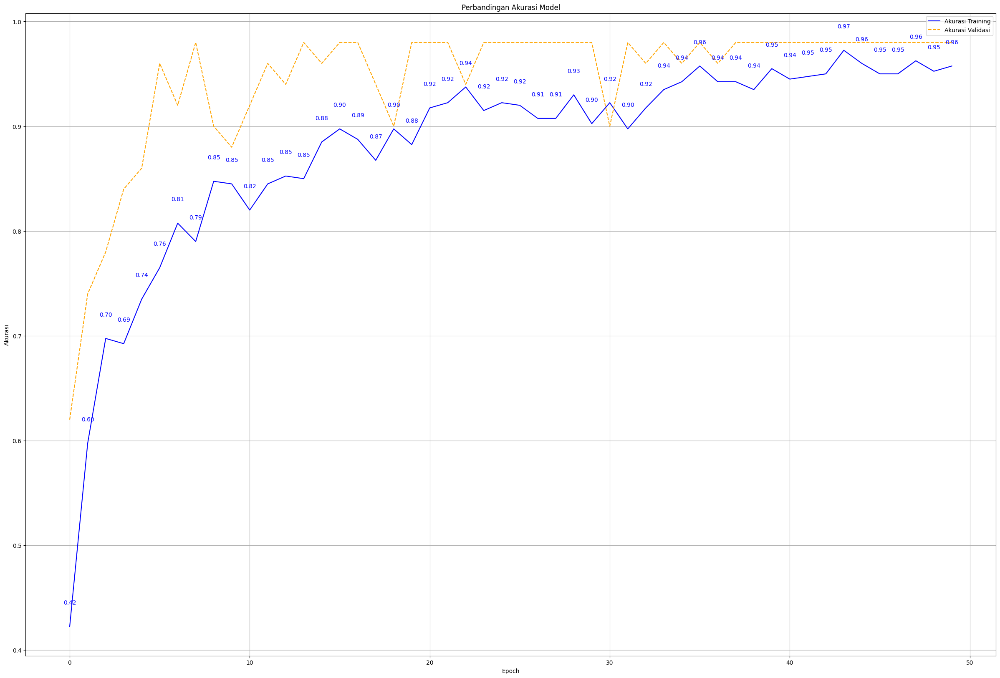

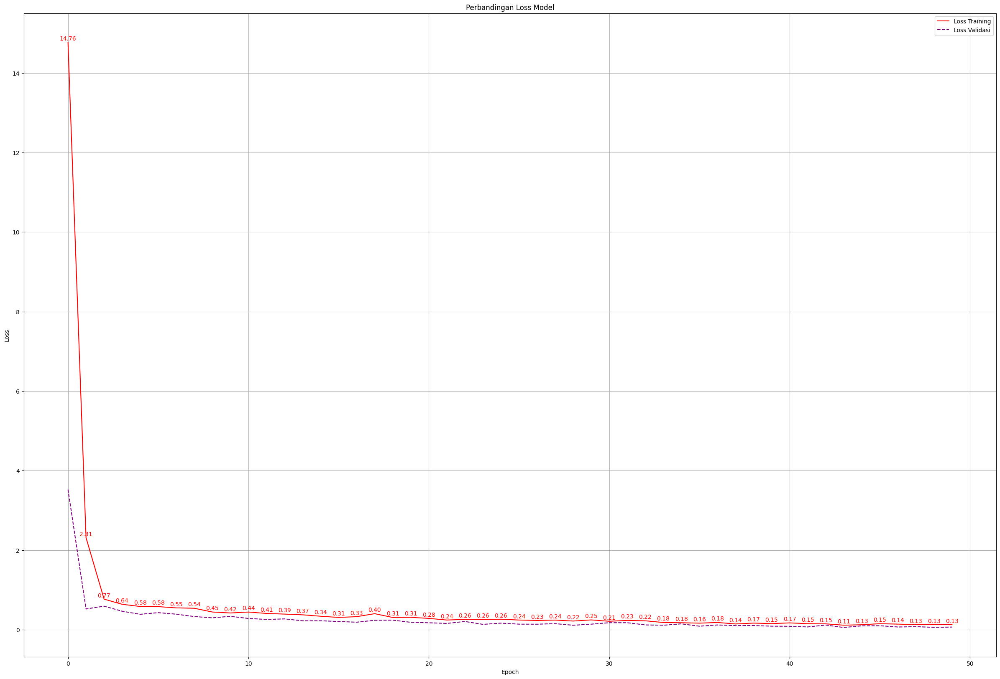

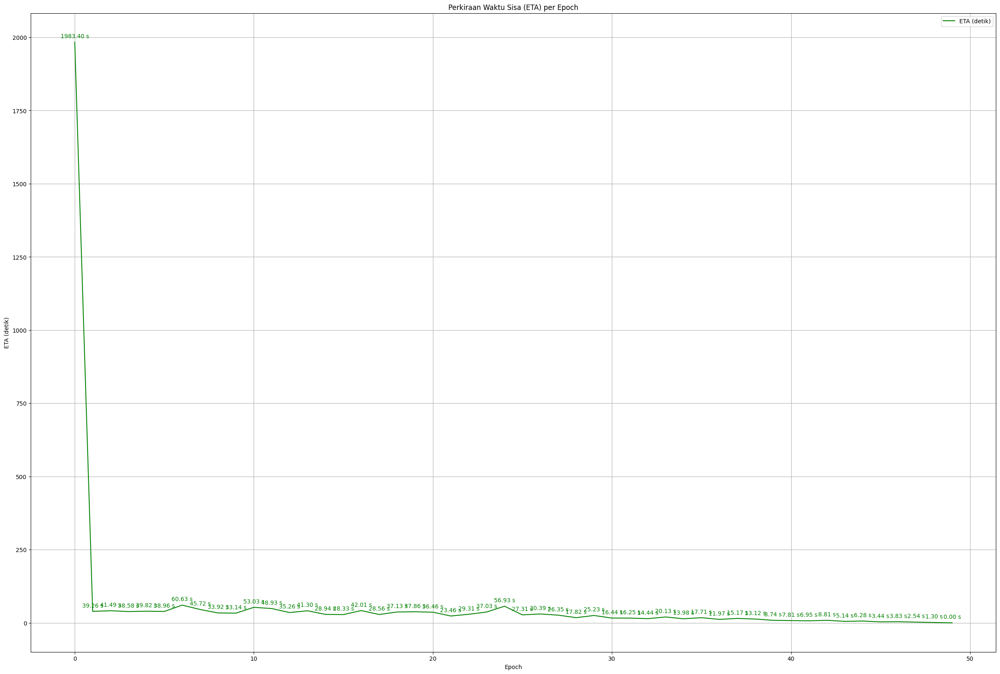

In [ ]:
# prompt: kemudian simpan masing-masing gambar  kurva dalam  bentuk file

# Simpan plot akurasi
plt.figure(figsize=(30, 20))
plt.plot(best_history.history['accuracy'], label='Akurasi Training', color='blue', linestyle='-')
plt.plot(best_history.history['val_accuracy'], label='Akurasi Validasi', color='orange', linestyle='--')
plt.title('Perbandingan Akurasi Model')
plt.xlabel('Epoch')
plt.ylabel('Akurasi')
plt.legend()
plt.grid(True)
for i, acc in enumerate(best_history.history['accuracy']):
    plt.text(i, acc + 0.02, f'{acc:.2f}', ha='center', va='bottom', fontsize=10, color='blue')
plt.savefig('akurasi_plot.png')  # Simpan plot akurasi sebagai file PNG

# Simpan plot loss
plt.figure(figsize=(30, 20))
plt.plot(best_history.history['loss'], label='Loss Training', color='red', linestyle='-')
plt.plot(best_history.history['val_loss'], label='Loss Validasi', color='purple', linestyle='--')
plt.title('Perbandingan Loss Model')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
for i, loss in enumerate(best_history.history['loss']):
    plt.text(i, loss + 0.02, f'{loss:.2f}', ha='center', va='bottom', fontsize=10, color='red')
plt.savefig('loss_plot.png')  # Simpan plot loss sebagai file PNG


# Plot kurva ETA
plt.figure(figsize=(30, 20))
plt.plot(best_eta_history, label='ETA (detik)', color='green', linestyle='-')
plt.title('Perkiraan Waktu Sisa (ETA) per Epoch')
plt.xlabel('Epoch')
plt.ylabel('ETA (detik)')
plt.legend()
plt.grid(True)

# Tambahkan anotasi ETA pada kurva
for i, eta in enumerate(best_eta_history):
    plt.text(i, eta + 10, f'{eta:.2f} s', ha='center', va='bottom', fontsize=10, color='green')

# Simpan plot ETA sebagai file PNG
plt.savefig('eta_plot.png')
plt.show()

5/5 ━━━━━━━━━━━━━━━━━━━━ 8s 960ms/step


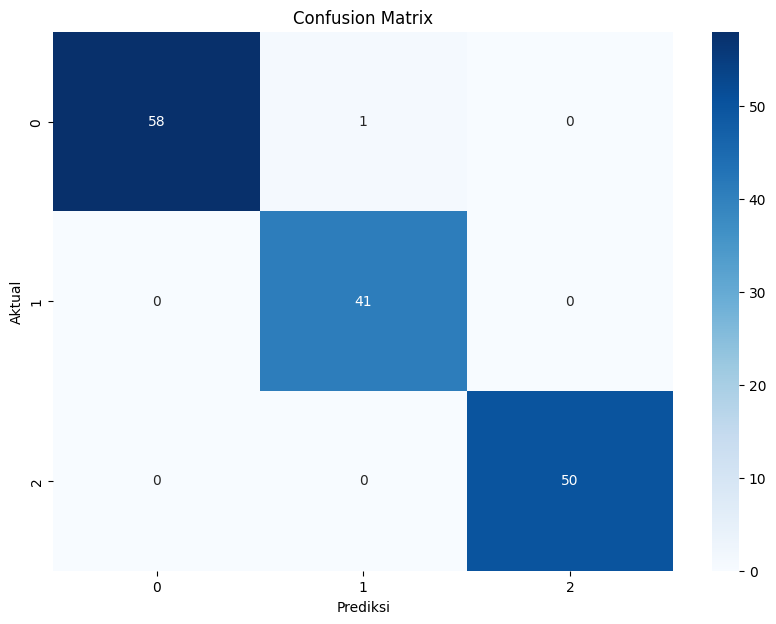

In [ ]:
# Prediksi pada data validasi
y_pred_proba = loaded_model.predict([X_test, color_features_test])
y_pred = np.argmax(y_pred_proba, axis=1)

# Hitung confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Tampilkan confusion matrix menggunakan seaborn
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Prediksi')
plt.ylabel('Aktual')
plt.title('Confusion Matrix')
plt.show()


In [ ]:
# prompt: kemudian saya ingin menampilkan nilai classification report

# Tampilkan classification report
print(classification_report(y_test, y_pred, target_names=['mentah', 'mengkal', 'matang']))


              precision    recall  f1-score   support

      mentah       1.00      0.98      0.99        59
     mengkal       0.98      1.00      0.99        41
      matang       1.00      1.00      1.00        50

    accuracy                           0.99       150
   macro avg       0.99      0.99      0.99       150
weighted avg       0.99      0.99      0.99       150



5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


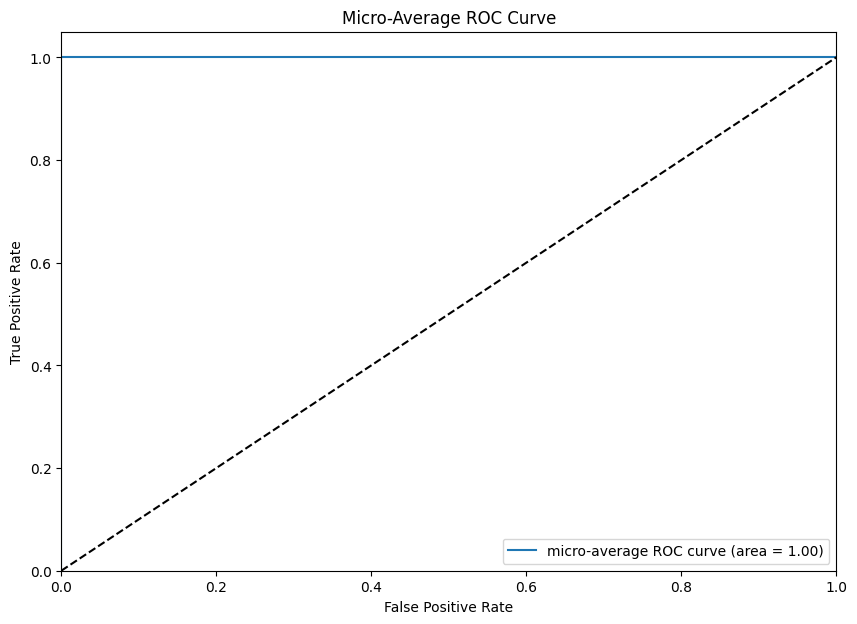

In [ ]:
# prompt: kemudian saya ingin menampilkan ROC Curve keseluruhan saja

# Hitung nilai prediksi probabilitas untuk setiap kelas
y_pred_proba = loaded_model.predict([X_val, color_features_val])

# Hitung ROC curve dan AUC untuk setiap kelas
fpr = dict()
tpr = dict()
roc_auc = dict()
n_classes = 3  # Jumlah kelas
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_val == i, y_pred_proba[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Hitung micro-average ROC curve dan AUC
fpr["micro"], tpr["micro"], _ = roc_curve(to_categorical(y_val).ravel(), y_pred_proba.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Plot micro-average ROC curve
plt.figure(figsize=(10, 7))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]))
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Micro-Average ROC Curve')
plt.legend(loc="lower right")
plt.show()


In [ ]:
# prompt: kemudian saya ingin menampilkan nilai akurasi, presisi, recall, f-1 score dari ketiga kelas

# Hitung precision, recall, dan F1-score untuk setiap kelas
precision, recall, f1_score, _ = precision_recall_fscore_support(y_test, y_pred, average=None)

# Tampilkan hasil
for i, label in enumerate(['mentah', 'mengkal', 'matang']):
    print(f"Kelas {label}:")
    print(f"  Akurasi: {cm[i, i] / sum(cm[i, :]):.2f}")
    print(f"  Presisi: {precision[i]:.2f}")
    print(f"  Recall: {recall[i]:.2f}")
    print(f"  F1-score: {f1_score[i]:.2f}")
    print()


Kelas mentah:
  Akurasi: 0.98
  Presisi: 1.00
  Recall: 0.98
  F1-score: 0.99

Kelas mengkal:
  Akurasi: 1.00
  Presisi: 0.98
  Recall: 1.00
  F1-score: 0.99

Kelas matang:
  Akurasi: 1.00
  Presisi: 1.00
  Recall: 1.00
  F1-score: 1.00



In [ ]:
# # Global DataFrame untuk menyimpan hasil
# df_results = pd.DataFrame(columns=['Mean_R', 'Mean_G', 'Mean_B', 'Mean_H', 'Mean_S', 'Mean_V', 'Prediction'])

# def process_uploaded_image():
#     global df_results  # Mengakses DataFrame global
#     try:
#         # Mengunggah file
#         uploaded = files.upload()

#         # Jika tidak ada file yang diupload (mungkin karena dibatalkan)
#         if not uploaded:
#             return

#         # List untuk menyimpan hasil prediksi dari gambar yang baru di-upload
#         new_results = []

#         for fn in uploaded.keys():
#             # Preprocessing gambar
#             path = fn
#             img = preprocess_image(path)

#             # Konversi ke RGB jika ada saluran alpha
#             if img.shape[2] == 4:  # Check if the image has 4 channels (RGBA)
#                 img = cv2.cvtColor(img, cv2.COLOR_RGBA2RGB)  # Convert RGBA to RGB

#             x = np.expand_dims(img, axis=0)

#             # Ekstrak fitur warna dari gambar yang diunggah
#             color_features_uploaded = extract_color_features(img)

#             # Skala fitur warna menggunakan scaler yang sama yang digunakan untuk data pelatihan
#             scaled_color_features_uploaded = scaler.transform(color_features_uploaded.reshape(1, -1))

#             # Melakukan prediksi dengan model yang telah dilatih
#             images = np.vstack([x])
#             classes = loaded_model.predict([images, scaled_color_features_uploaded], batch_size=10)
#             result = np.argmax(classes)

#             # Simpan hasil prediksi dari gambar yang baru di-upload
#             result_row = np.append(scaled_color_features_uploaded.flatten(), result).tolist()
#             new_results.append(result_row)

#             # Tampilkan hasil prediksi untuk gambar yang baru di-upload
#             if result == 0:
#                 print(f"Image '{fn}' is mentah")
#             elif result == 1:
#                 print(f"Image '{fn}' is mengkal")
#             elif result == 2:
#                 print(f"Image '{fn}' is matang")

#             plt.imshow(img)
#             plt.title(f"Prediction: {result}")
#             plt.show()

#         # Membuat DataFrame dari hasil gambar yang baru di-upload
#         df_new_results = pd.DataFrame(new_results, columns=['Mean_R', 'Mean_G', 'Mean_B', 'Mean_H', 'Mean_S', 'Mean_V', 'Prediction'])

#         # Gabungkan hasil baru dengan DataFrame global
#         df_results = pd.concat([df_results, df_new_results], ignore_index=True)

#         # Tampilkan DataFrame hasil
#         print("DataFrame Hasil:")
#         print(df_results)

#     except Exception as e:
#         print("Upload dibatalkan atau terjadi kesalahan:", e)

# def repeat_upload():
#     while True:
#         process_uploaded_image()
#         # Opsi: menghentikan loop setelah proses upload jika diinginkan
#         cont = input("Apakah Anda ingin mengupload gambar lain? (y/n): ").strip().lower()
#         if cont != 'y':
#             break  # Menghentikan loop jika tidak ada upload gambar lebih lanjut

# # Mulai proses upload dan pemrosesan
# repeat_upload()

Saving Mature_001.jpg to Mature_001 (1).jpg
Saving Mature_002.jpg to Mature_002 (1).jpg
Saving Mature_003.jpg to Mature_003 (1).jpg
Saving Mature_004.jpg to Mature_004 (1).jpg
Saving Mature_005.jpg to Mature_005 (1).jpg
Saving Mature_006.jpg to Mature_006.jpg
Saving Mature_007.jpg to Mature_007.jpg
Saving Mature_008.jpg to Mature_008.jpg
Saving Mature_009.jpg to Mature_009.jpg
Saving Mature_010.jpg to Mature_010.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image 'Mature_001 (1).jpg' is matang


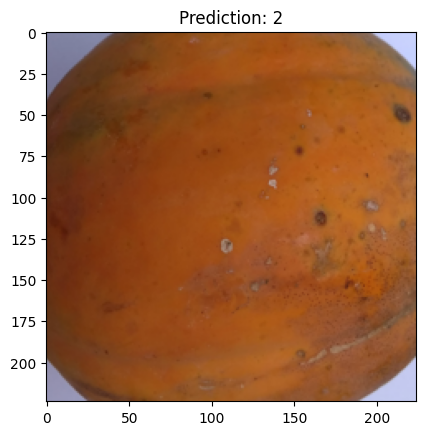

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'Mature_002 (1).jpg' is matang


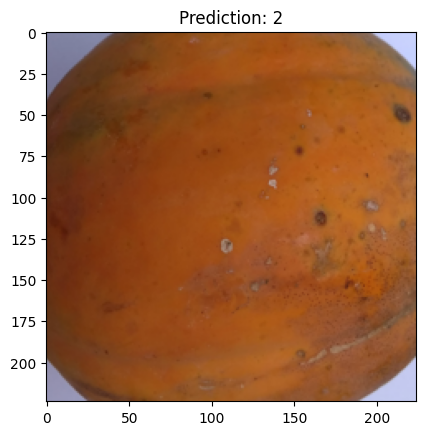

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image 'Mature_003 (1).jpg' is matang


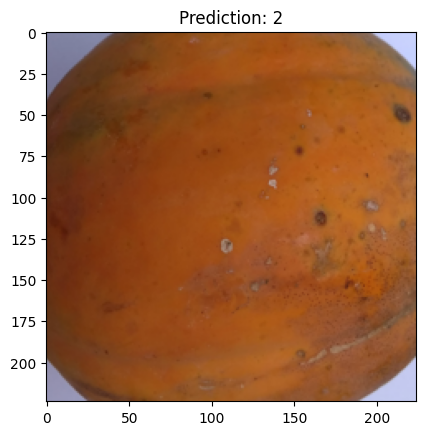

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Image 'Mature_004 (1).jpg' is matang


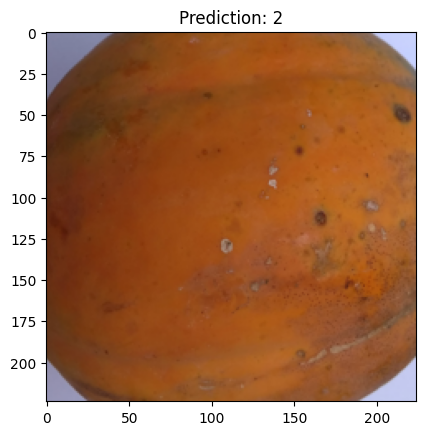

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image 'Mature_005 (1).jpg' is matang


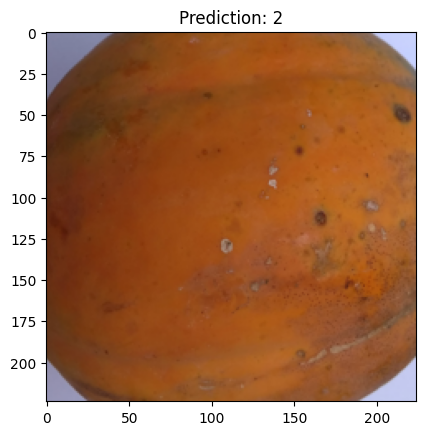

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'Mature_006.jpg' is matang


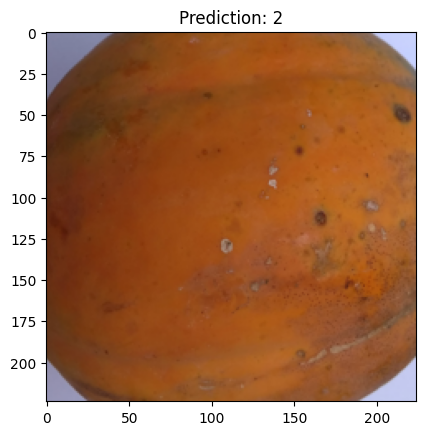

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image 'Mature_007.jpg' is matang


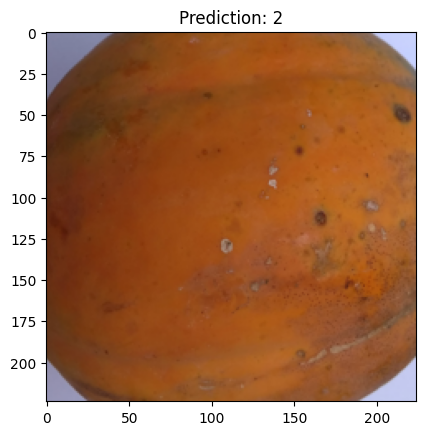

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'Mature_008.jpg' is matang


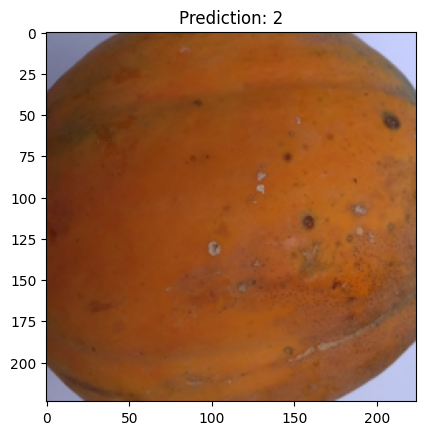

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image 'Mature_009.jpg' is matang


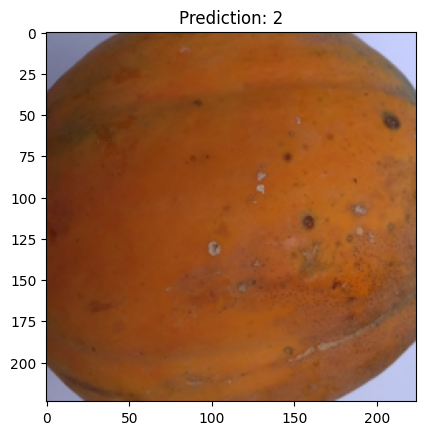

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'Mature_010.jpg' is matang


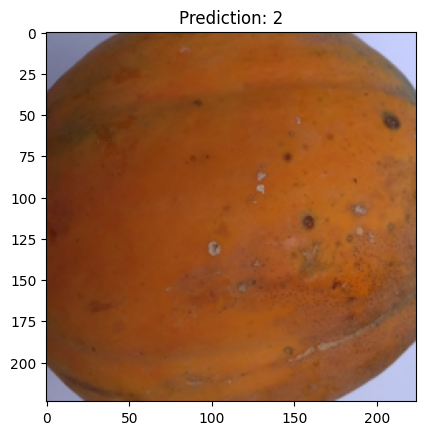

DataFrame Hasil:
             filepath    Mean_R    Mean_G    Mean_B    Mean_H    Mean_S  \
0  Mature_001 (1).jpg -1.236415 -0.873134  0.822575  1.545085  1.698511   
1  Mature_002 (1).jpg -1.236415 -0.873134  0.822575  1.545085  1.698511   
2  Mature_003 (1).jpg -1.236415 -0.873134  0.822575  1.545085  1.698511   
3  Mature_004 (1).jpg -1.236415 -0.873134  0.822575  1.545085  1.698511   
4  Mature_005 (1).jpg -1.236415 -0.873134  0.822575  1.545085  1.698511   
5      Mature_006.jpg -1.236415 -0.873134  0.822575  1.545085  1.698511   
6      Mature_007.jpg -1.236415 -0.873134  0.822575  1.545085  1.698511   
7      Mature_008.jpg -1.118528 -0.850539  0.771125  1.394745  1.613078   
8      Mature_009.jpg -1.118528 -0.850539  0.771125  1.394745  1.613078   
9      Mature_010.jpg -1.118528 -0.850539  0.771125  1.394745  1.613078   

     Mean_V  Prediction  
0  0.572410         2.0  
1  0.572410         2.0  
2  0.572410         2.0  
3  0.572410         2.0  
4  0.572410         2.0  
5

Saving partiallymature_001.jpg to partiallymature_001 (1).jpg
Saving partiallymature_002.jpg to partiallymature_002 (1).jpg
Saving partiallymature_003.jpg to partiallymature_003 (1).jpg
Saving partiallymature_004.jpg to partiallymature_004 (1).jpg
Saving partiallymature_005.jpg to partiallymature_005 (1).jpg
Saving partiallymature_006.jpg to partiallymature_006.jpg
Saving partiallymature_007.jpg to partiallymature_007.jpg
Saving partiallymature_008.jpg to partiallymature_008.jpg
Saving partiallymature_009.jpg to partiallymature_009.jpg
Saving partiallymature_010.jpg to partiallymature_010.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image 'partiallymature_001 (1).jpg' is mengkal


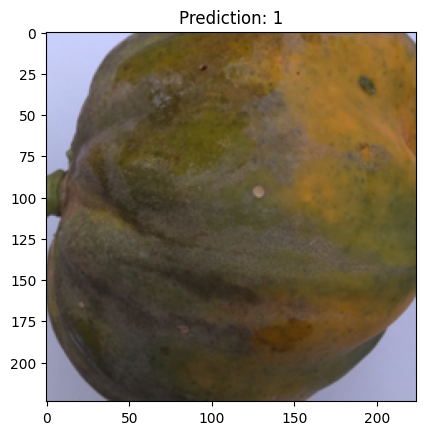

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'partiallymature_002 (1).jpg' is mengkal


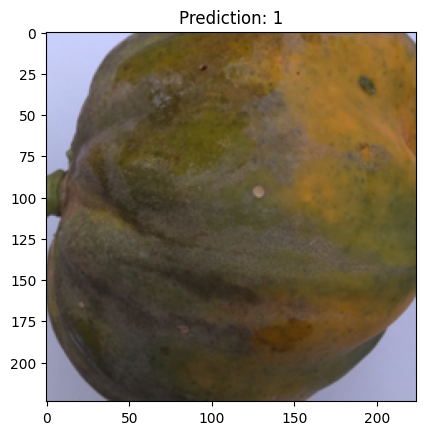

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'partiallymature_003 (1).jpg' is mengkal


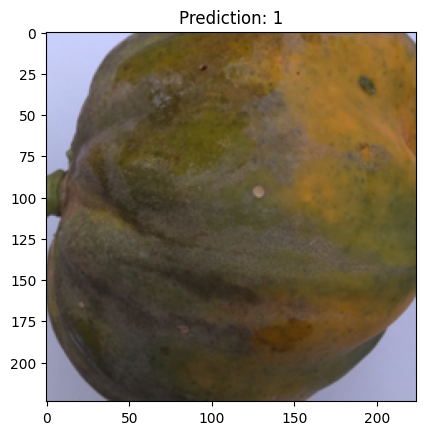

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'partiallymature_004 (1).jpg' is mengkal


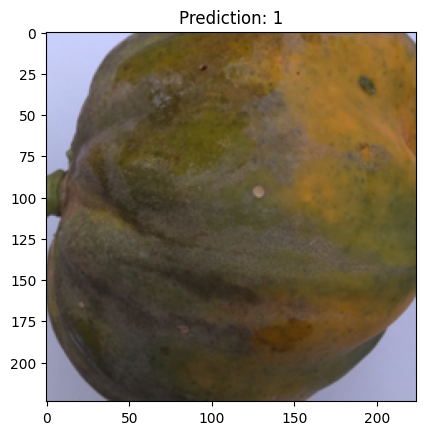

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image 'partiallymature_005 (1).jpg' is mengkal


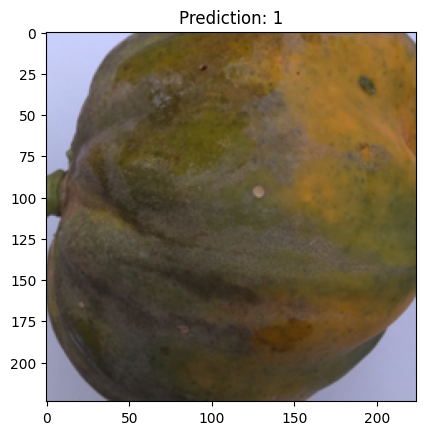

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'partiallymature_006.jpg' is mengkal


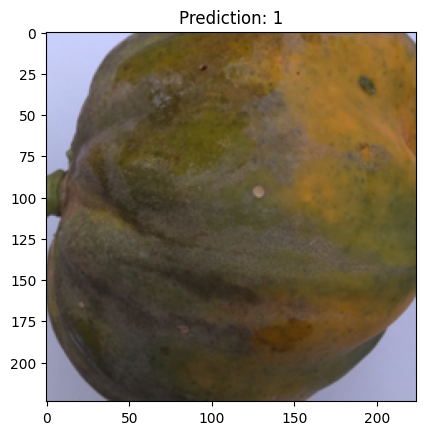

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image 'partiallymature_007.jpg' is mengkal


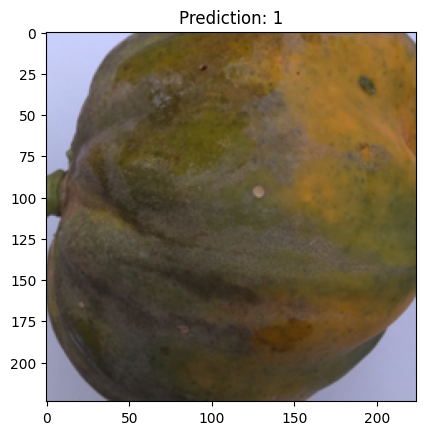

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'partiallymature_008.jpg' is mengkal


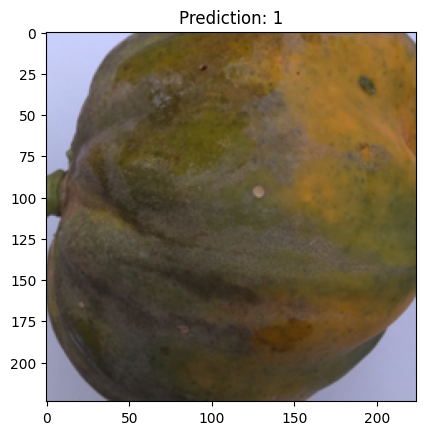

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image 'partiallymature_009.jpg' is mengkal


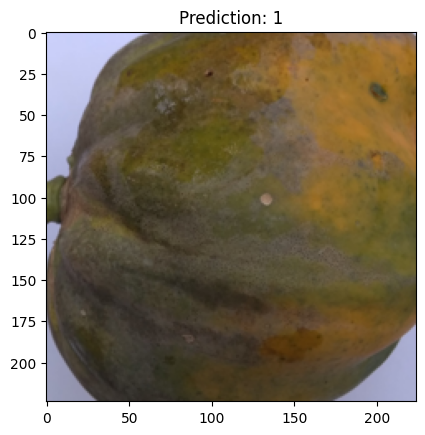

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'partiallymature_010.jpg' is mengkal


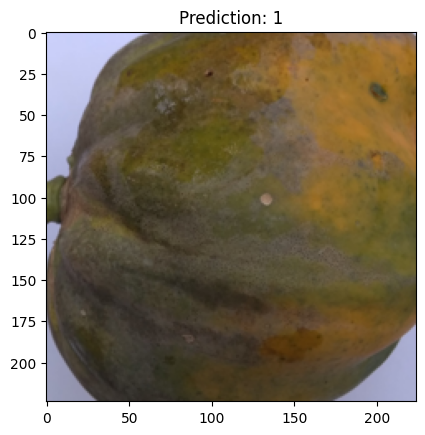

DataFrame Hasil:
                       filepath    Mean_R    Mean_G    Mean_B    Mean_H  \
0            Mature_001 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
1            Mature_002 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
2            Mature_003 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
3            Mature_004 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
4            Mature_005 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
5                Mature_006.jpg -1.236415 -0.873134  0.822575  1.545085   
6                Mature_007.jpg -1.236415 -0.873134  0.822575  1.545085   
7                Mature_008.jpg -1.118528 -0.850539  0.771125  1.394745   
8                Mature_009.jpg -1.118528 -0.850539  0.771125  1.394745   
9                Mature_010.jpg -1.118528 -0.850539  0.771125  1.394745   
10  partiallymature_001 (1).jpg -0.142054 -0.643937 -0.348298  0.695415   
11  partiallymature_002 (1).jpg -0.142054 -0.643937 -0.348298  0.695415   
12  part

Saving unmature_001.jpg to unmature_001.jpg
Saving unmature_002.jpg to unmature_002.jpg
Saving unmature_003.jpg to unmature_003.jpg
Saving unmature_004.jpg to unmature_004.jpg
Saving unmature_005.jpg to unmature_005.jpg
Saving unmature_006.jpg to unmature_006.jpg
Saving unmature_007.jpg to unmature_007.jpg
Saving unmature_008.jpg to unmature_008.jpg
Saving unmature_009.jpg to unmature_009.jpg
Saving unmature_010.jpg to unmature_010.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image 'unmature_001.jpg' is mentah


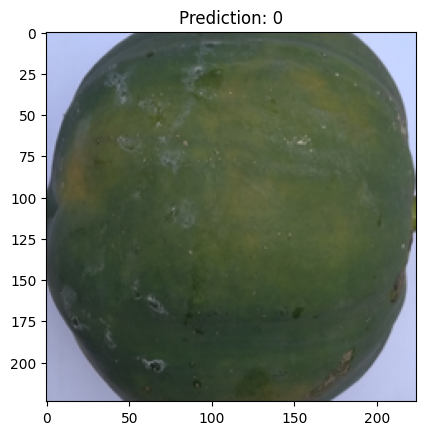

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image 'unmature_002.jpg' is mentah


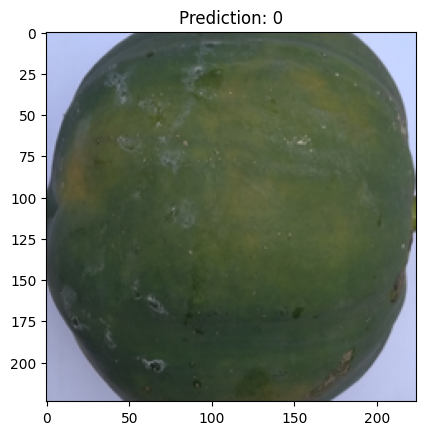

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'unmature_003.jpg' is mentah


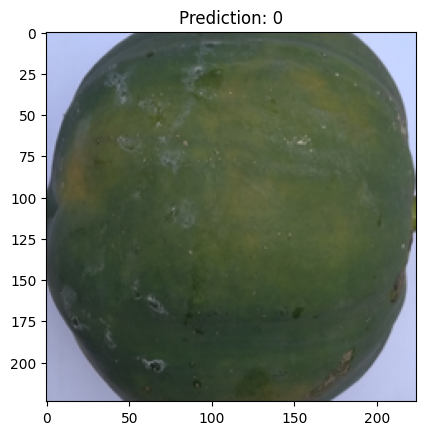

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Image 'unmature_004.jpg' is mentah


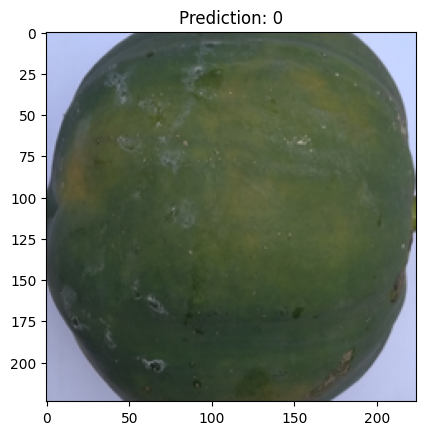

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image 'unmature_005.jpg' is mentah


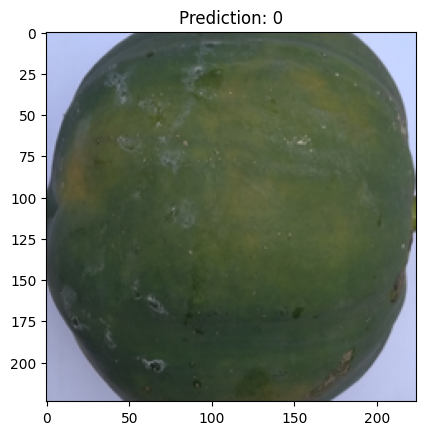

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image 'unmature_006.jpg' is mentah


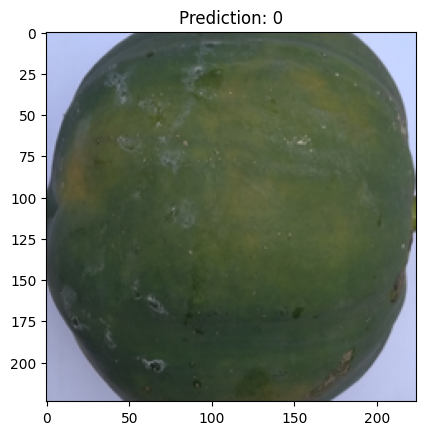

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Image 'unmature_007.jpg' is mentah


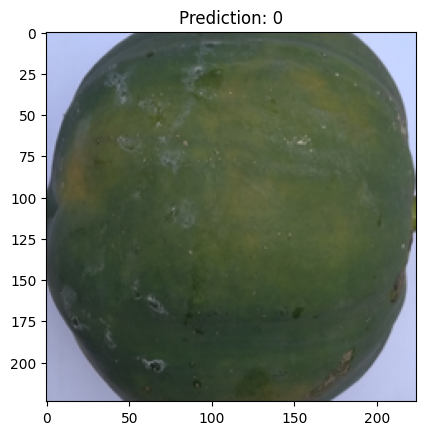

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Image 'unmature_008.jpg' is mentah


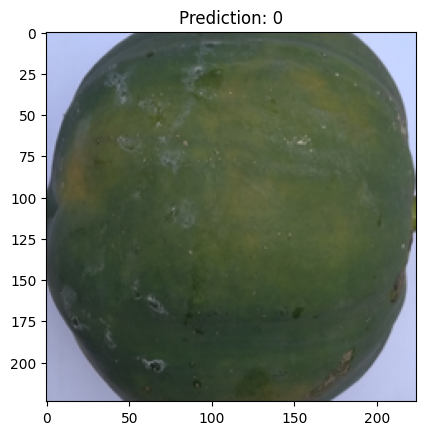

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image 'unmature_009.jpg' is mentah


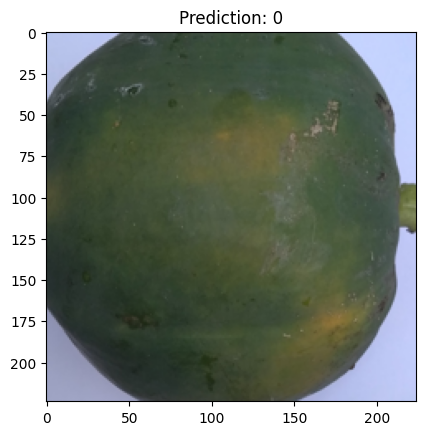

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Image 'unmature_010.jpg' is mentah


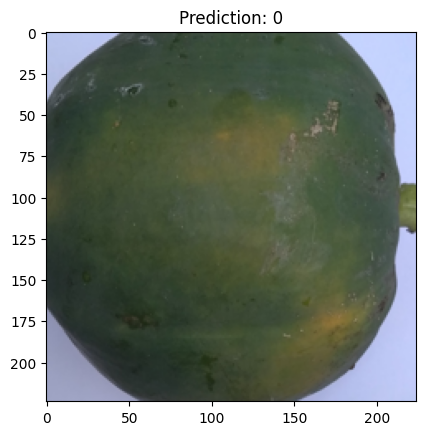

DataFrame Hasil:
                       filepath    Mean_R    Mean_G    Mean_B    Mean_H  \
0            Mature_001 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
1            Mature_002 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
2            Mature_003 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
3            Mature_004 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
4            Mature_005 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
5                Mature_006.jpg -1.236415 -0.873134  0.822575  1.545085   
6                Mature_007.jpg -1.236415 -0.873134  0.822575  1.545085   
7                Mature_008.jpg -1.118528 -0.850539  0.771125  1.394745   
8                Mature_009.jpg -1.118528 -0.850539  0.771125  1.394745   
9                Mature_010.jpg -1.118528 -0.850539  0.771125  1.394745   
10  partiallymature_001 (1).jpg -0.142054 -0.643937 -0.348298  0.695415   
11  partiallymature_002 (1).jpg -0.142054 -0.643937 -0.348298  0.695415   
12  part

Saving Mature_021.jpg to Mature_021.jpg
Saving Mature_022.jpg to Mature_022.jpg
Saving Mature_023.jpg to Mature_023.jpg
Saving Mature_024.jpg to Mature_024.jpg
Saving Mature_025.jpg to Mature_025.jpg
Saving Mature_026.jpg to Mature_026.jpg
Saving Mature_027.jpg to Mature_027.jpg
Saving Mature_028.jpg to Mature_028.jpg
Saving Mature_029.jpg to Mature_029.jpg
Saving Mature_030.jpg to Mature_030.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'Mature_021.jpg' is matang


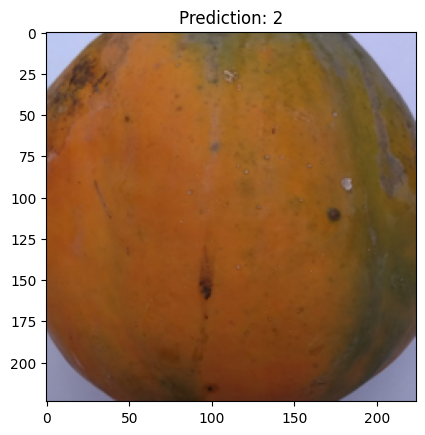

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Image 'Mature_022.jpg' is matang


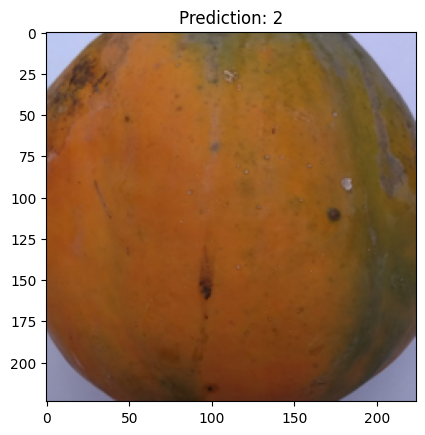

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Image 'Mature_023.jpg' is matang


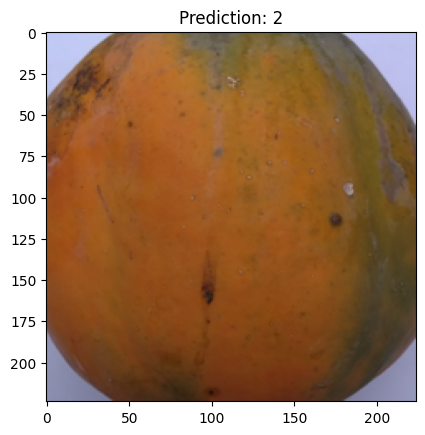

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Image 'Mature_024.jpg' is matang


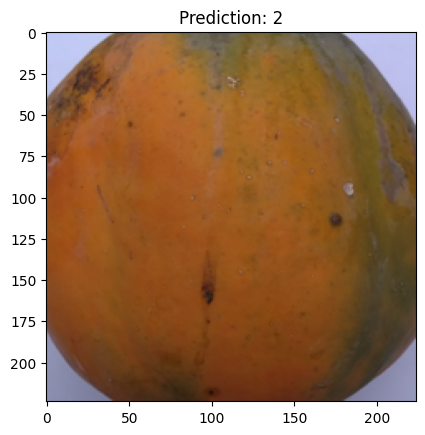

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Image 'Mature_025.jpg' is matang


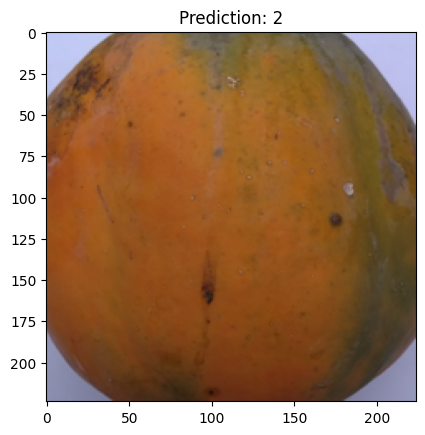

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Image 'Mature_026.jpg' is matang


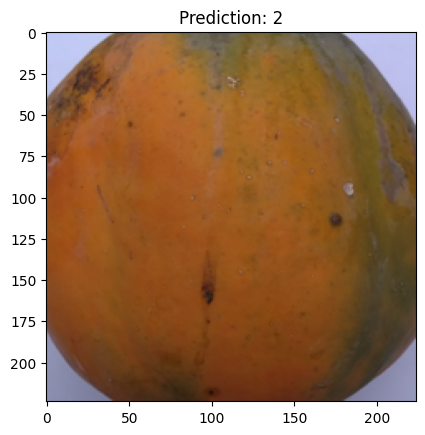

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Image 'Mature_027.jpg' is matang


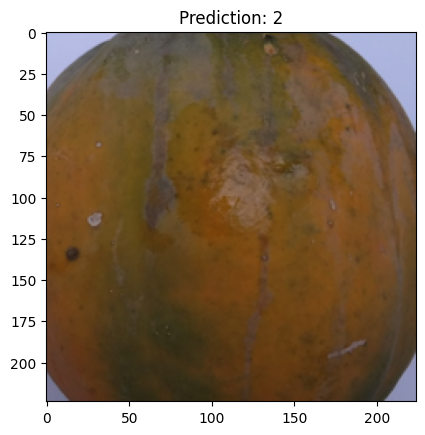

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Image 'Mature_028.jpg' is matang


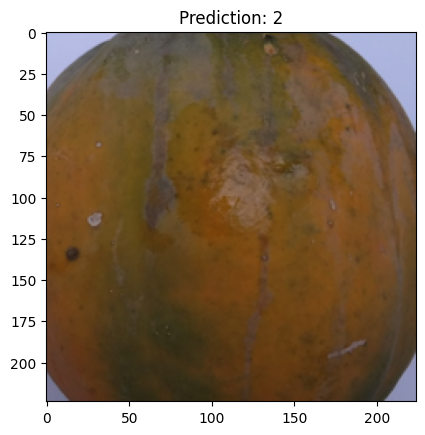

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Image 'Mature_029.jpg' is matang


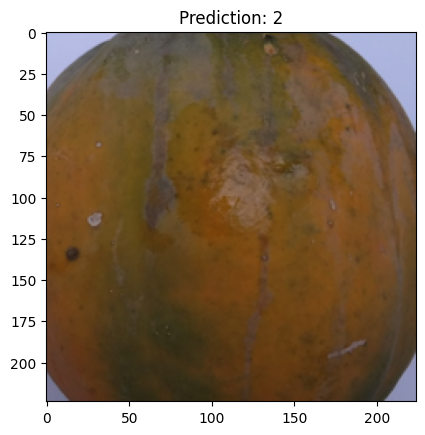

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Image 'Mature_030.jpg' is matang


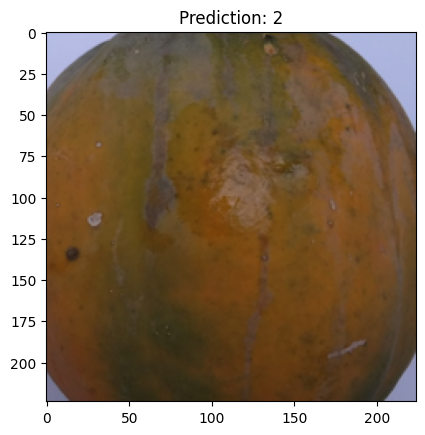

DataFrame Hasil:
                       filepath    Mean_R    Mean_G    Mean_B    Mean_H  \
0            Mature_001 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
1            Mature_002 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
2            Mature_003 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
3            Mature_004 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
4            Mature_005 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
5                Mature_006.jpg -1.236415 -0.873134  0.822575  1.545085   
6                Mature_007.jpg -1.236415 -0.873134  0.822575  1.545085   
7                Mature_008.jpg -1.118528 -0.850539  0.771125  1.394745   
8                Mature_009.jpg -1.118528 -0.850539  0.771125  1.394745   
9                Mature_010.jpg -1.118528 -0.850539  0.771125  1.394745   
10  partiallymature_001 (1).jpg -0.142054 -0.643937 -0.348298  0.695415   
11  partiallymature_002 (1).jpg -0.142054 -0.643937 -0.348298  0.695415   
12  part

Saving partiallymature_021.jpg to partiallymature_021.jpg
Saving partiallymature_022.jpg to partiallymature_022.jpg
Saving partiallymature_023.jpg to partiallymature_023.jpg
Saving partiallymature_024.jpg to partiallymature_024.jpg
Saving partiallymature_025.jpg to partiallymature_025.jpg
Saving partiallymature_026.jpg to partiallymature_026.jpg
Saving partiallymature_027.jpg to partiallymature_027.jpg
Saving partiallymature_028.jpg to partiallymature_028.jpg
Saving partiallymature_029.jpg to partiallymature_029.jpg
Saving partiallymature_030.jpg to partiallymature_030.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Image 'partiallymature_021.jpg' is mengkal


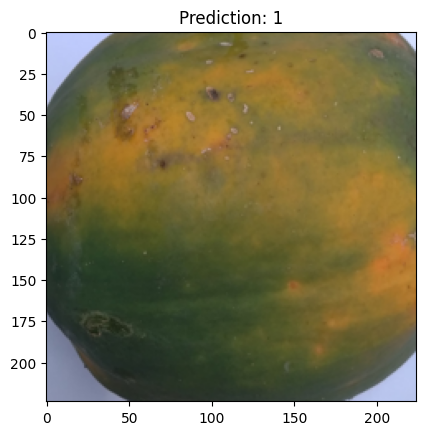

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
Image 'partiallymature_022.jpg' is mengkal


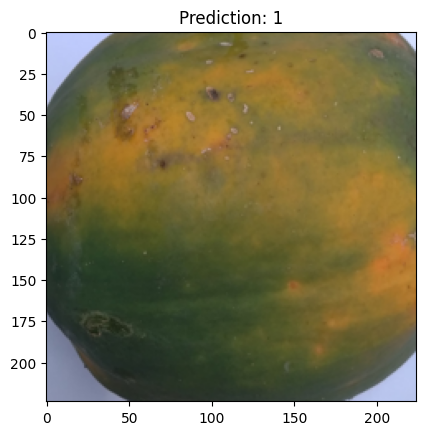

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Image 'partiallymature_023.jpg' is mengkal


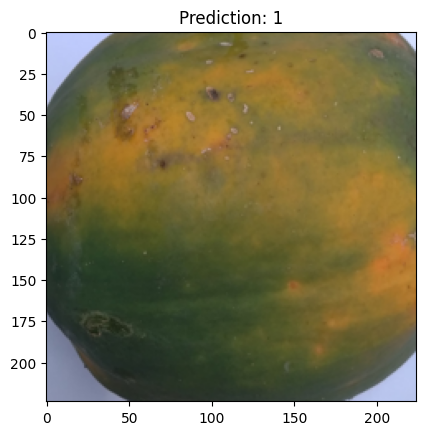

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Image 'partiallymature_024.jpg' is mengkal


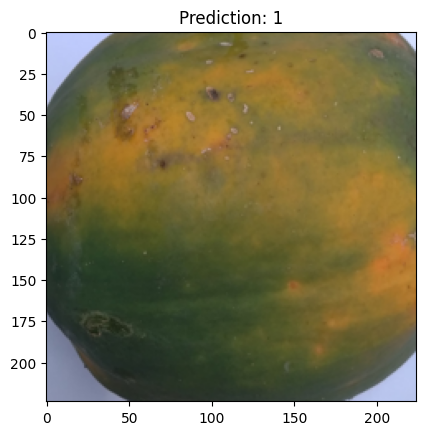

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Image 'partiallymature_025.jpg' is mengkal


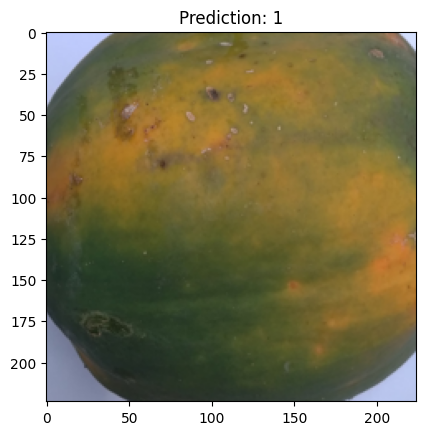

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Image 'partiallymature_026.jpg' is mengkal


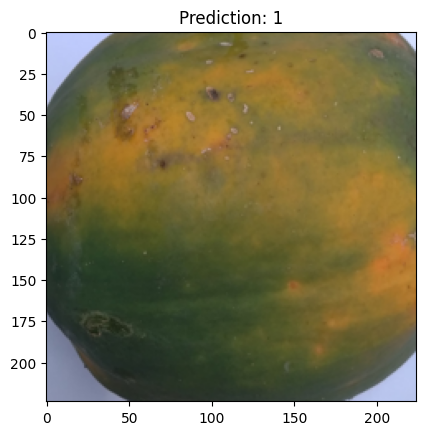

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Image 'partiallymature_027.jpg' is mengkal


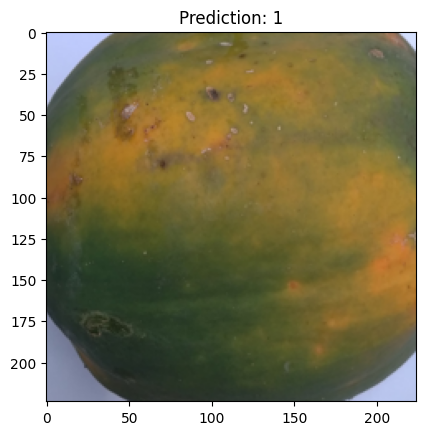

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Image 'partiallymature_028.jpg' is mengkal


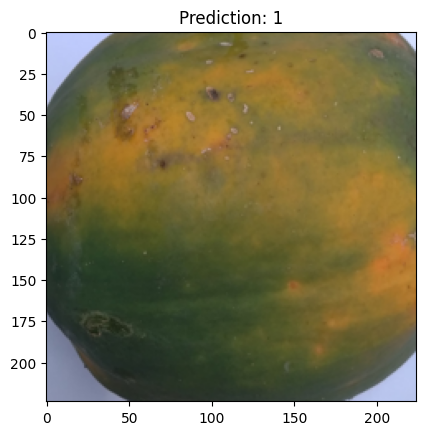

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Image 'partiallymature_029.jpg' is mengkal


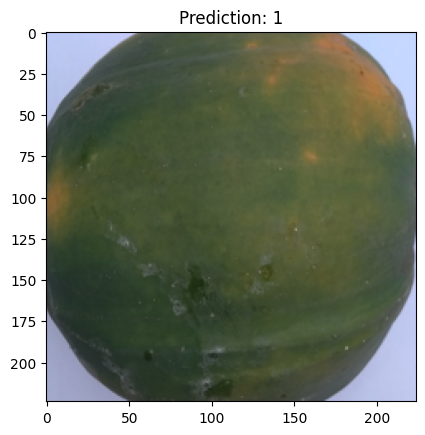

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Image 'partiallymature_030.jpg' is mengkal


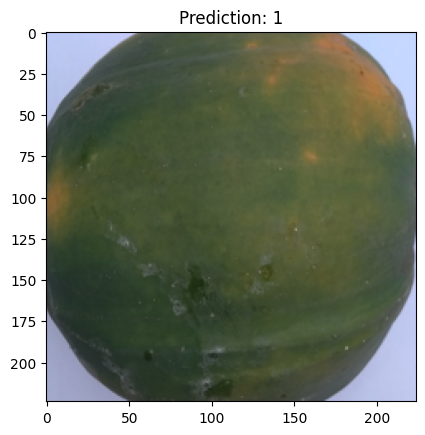

DataFrame Hasil:
                       filepath    Mean_R    Mean_G    Mean_B    Mean_H  \
0            Mature_001 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
1            Mature_002 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
2            Mature_003 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
3            Mature_004 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
4            Mature_005 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
5                Mature_006.jpg -1.236415 -0.873134  0.822575  1.545085   
6                Mature_007.jpg -1.236415 -0.873134  0.822575  1.545085   
7                Mature_008.jpg -1.118528 -0.850539  0.771125  1.394745   
8                Mature_009.jpg -1.118528 -0.850539  0.771125  1.394745   
9                Mature_010.jpg -1.118528 -0.850539  0.771125  1.394745   
10  partiallymature_001 (1).jpg -0.142054 -0.643937 -0.348298  0.695415   
11  partiallymature_002 (1).jpg -0.142054 -0.643937 -0.348298  0.695415   
12  part

Saving unmature_021.jpg to unmature_021.jpg
Saving unmature_022.jpg to unmature_022.jpg
Saving unmature_023.jpg to unmature_023.jpg
Saving unmature_024.jpg to unmature_024.jpg
Saving unmature_025.jpg to unmature_025.jpg
Saving unmature_026.jpg to unmature_026.jpg
Saving unmature_027.jpg to unmature_027.jpg
Saving unmature_028.jpg to unmature_028.jpg
Saving unmature_029.jpg to unmature_029.jpg
Saving unmature_030.jpg to unmature_030.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image 'unmature_021.jpg' is mentah


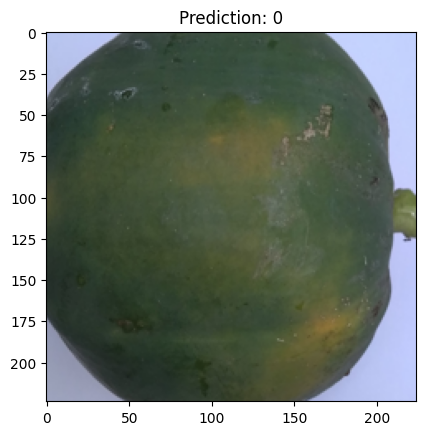

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Image 'unmature_022.jpg' is mentah


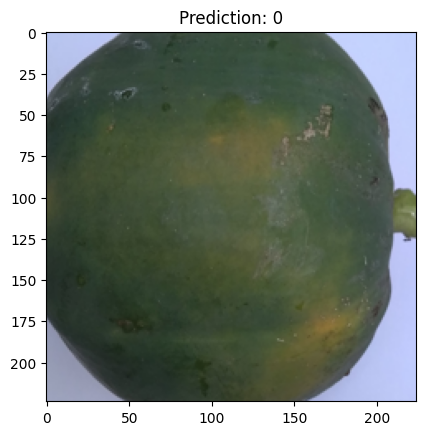

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Image 'unmature_023.jpg' is mentah


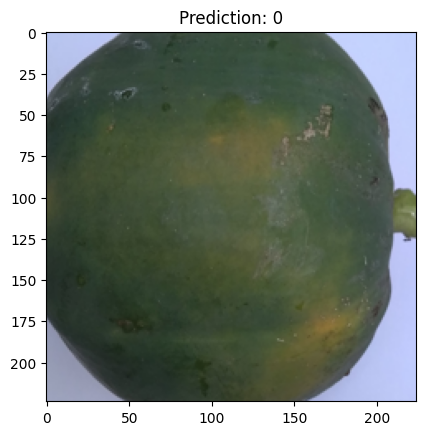

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Image 'unmature_024.jpg' is mentah


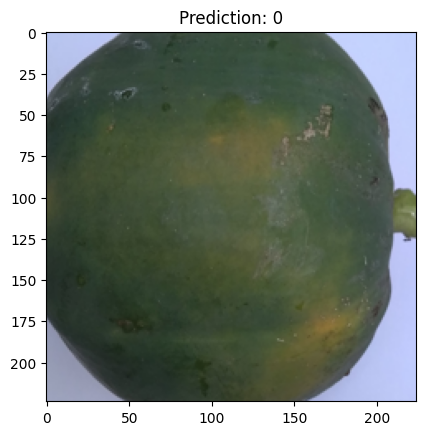

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Image 'unmature_025.jpg' is mentah


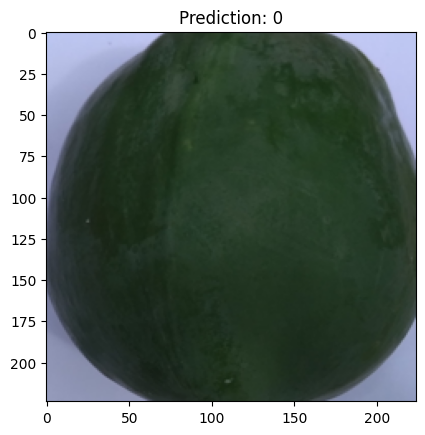

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Image 'unmature_026.jpg' is mentah


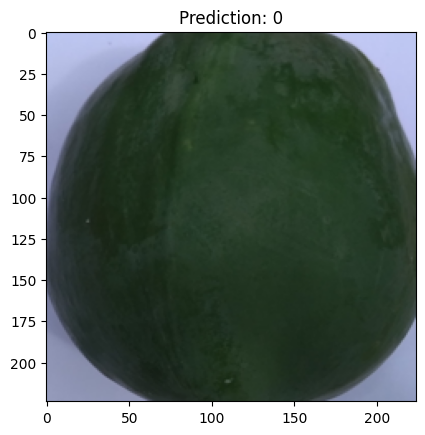

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Image 'unmature_027.jpg' is mentah


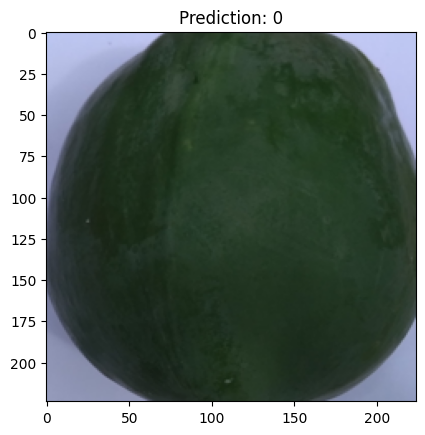

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Image 'unmature_028.jpg' is mentah


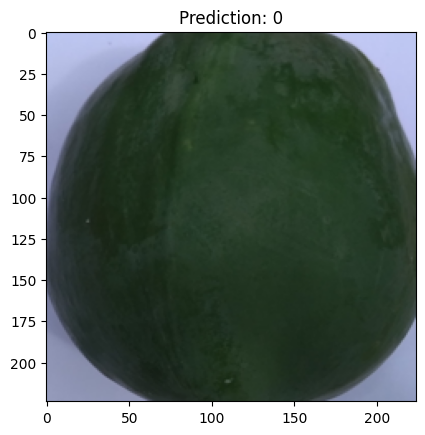

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Image 'unmature_029.jpg' is mentah


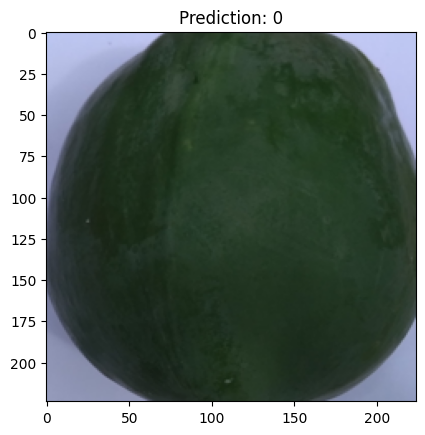

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
Image 'unmature_030.jpg' is mentah


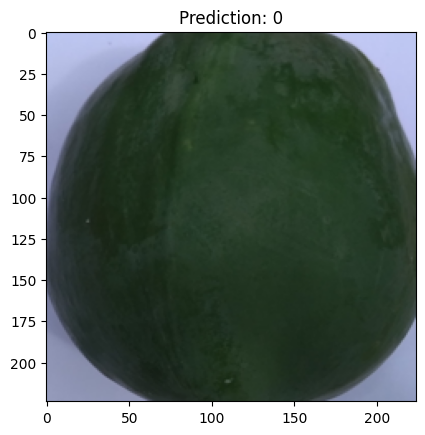

DataFrame Hasil:
                       filepath    Mean_R    Mean_G    Mean_B    Mean_H  \
0            Mature_001 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
1            Mature_002 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
2            Mature_003 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
3            Mature_004 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
4            Mature_005 (1).jpg -1.236415 -0.873134  0.822575  1.545085   
5                Mature_006.jpg -1.236415 -0.873134  0.822575  1.545085   
6                Mature_007.jpg -1.236415 -0.873134  0.822575  1.545085   
7                Mature_008.jpg -1.118528 -0.850539  0.771125  1.394745   
8                Mature_009.jpg -1.118528 -0.850539  0.771125  1.394745   
9                Mature_010.jpg -1.118528 -0.850539  0.771125  1.394745   
10  partiallymature_001 (1).jpg -0.142054 -0.643937 -0.348298  0.695415   
11  partiallymature_002 (1).jpg -0.142054 -0.643937 -0.348298  0.695415   
12  part

In [ ]:
# Global DataFrame untuk menyimpan hasil
df_results = pd.DataFrame(columns=['filepath', 'Mean_R', 'Mean_G', 'Mean_B', 'Mean_H', 'Mean_S', 'Mean_V', 'Prediction'])

def process_uploaded_image():
    global df_results  # Mengakses DataFrame global
    try:
        # Mengunggah file
        uploaded = files.upload()

        # Jika tidak ada file yang diupload (mungkin karena dibatalkan)
        if not uploaded:
            return

        # List untuk menyimpan hasil prediksi dari gambar yang baru di-upload
        new_results = []

        for fn in uploaded.keys():
            # Preprocessing gambar
            path = fn
            img = preprocess_image(path)

            # Konversi ke RGB jika ada saluran alpha
            if img.shape[2] == 4:  # Check if the image has 4 channels (RGBA)
                img = cv2.cvtColor(img, cv2.COLOR_RGBA2RGB)  # Convert RGBA to RGB

            x = np.expand_dims(img, axis=0)

            # Ekstrak fitur warna dari gambar yang diunggah
            color_features_uploaded = extract_color_features(img)

            # Skala fitur warna menggunakan scaler yang sama yang digunakan untuk data pelatihan
            scaled_color_features_uploaded = scaler.transform(color_features_uploaded.reshape(1, -1))

            # Melakukan prediksi dengan model yang telah dilatih
            images = np.vstack([x])
            classes = loaded_model.predict([images, scaled_color_features_uploaded], batch_size=10)
            result = np.argmax(classes)

            # Simpan hasil prediksi dari gambar yang baru di-upload
            result_row = [path] + np.append(scaled_color_features_uploaded.flatten(), result).tolist()
            new_results.append(result_row)

            # Tampilkan hasil prediksi untuk gambar yang baru di-upload
            if result == 0:
                print(f"Image '{fn}' is mentah")
            elif result == 1:
                print(f"Image '{fn}' is mengkal")
            elif result == 2:
                print(f"Image '{fn}' is matang")

            plt.imshow(img)
            plt.title(f"Prediction: {result}")
            plt.show()

        # Membuat DataFrame dari hasil gambar yang baru di-upload
        df_new_results = pd.DataFrame(new_results, columns=['filepath', 'Mean_R', 'Mean_G', 'Mean_B', 'Mean_H', 'Mean_S', 'Mean_V', 'Prediction'])

        # Gabungkan hasil baru dengan DataFrame global
        df_results = pd.concat([df_results, df_new_results], ignore_index=True)

        # Tampilkan DataFrame hasil
        print("DataFrame Hasil:")
        print(df_results)

    except Exception as e:
        print("Upload dibatalkan atau terjadi kesalahan:", e)

def repeat_upload():
    while True:
        process_uploaded_image()
        # Opsi: menghentikan loop setelah proses upload jika diinginkan
        cont = input("Apakah Anda ingin mengupload gambar lain? (y/n): ").strip().lower()
        if cont != 'y':
            break  # Menghentikan loop jika tidak ada upload gambar lebih lanjut

# Mulai proses upload dan pemrosesan
repeat_upload()

In [ ]:
# prompt: kemudian tampilkan dataframe

# Assuming 'df_results' is the DataFrame from the previous code
if 'df_results' in locals():
  display(df_results)
else:
  print("DataFrame 'df_results' tidak ditemukan.")


,filepath,Mean_R,Mean_G,Mean_B,Mean_H,Mean_S,Mean_V,Prediction
0,Mature_001 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0
1,Mature_002 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0
2,Mature_003 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0
3,Mature_004 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0
4,Mature_005 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0
5,Mature_006.jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0
6,Mature_007.jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0
7,Mature_008.jpg,-1.118528,-0.850539,0.771125,1.394745,1.613078,0.536106,2.0
8,Mature_009.jpg,-1.118528,-0.850539,0.771125,1.394745,1.613078,0.536106,2.0
9,Mature_010.jpg,-1.118528,-0.850539,0.771125,1.394745,1.613078,0.536106,2.0


In [ ]:
# prompt: kemudian masukkan nilai kematangannya jika nilai prediksinya 2 maka kategori buah tersebut hanya dijual dalam daerah itu saja. jika nilai prediksinya 1  maka dapat dikirim antar kabupaten. dan jika nilai prediksinya 0 maka bisa dikirim keluar daerah

# Menambahkan kolom 'Keterangan' berdasarkan nilai 'Prediction'
df_results['Keterangan'] = df_results['Prediction'].apply(lambda x:
    'Dijual dalam daerah saja' if x == 2
    else ('Dapat dikirim antar kabupaten' if x == 1
          else 'Bisa dikirim keluar daerah')
)

# Menampilkan DataFrame yang telah diperbarui
display(df_results)


,filepath,Mean_R,Mean_G,Mean_B,Mean_H,Mean_S,Mean_V,Prediction,Keterangan
0,Mature_001 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
1,Mature_002 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
2,Mature_003 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
3,Mature_004 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
4,Mature_005 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
5,Mature_006.jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
6,Mature_007.jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
7,Mature_008.jpg,-1.118528,-0.850539,0.771125,1.394745,1.613078,0.536106,2.0,Dijual dalam daerah saja
8,Mature_009.jpg,-1.118528,-0.850539,0.771125,1.394745,1.613078,0.536106,2.0,Dijual dalam daerah saja
9,Mature_010.jpg,-1.118528,-0.850539,0.771125,1.394745,1.613078,0.536106,2.0,Dijual dalam daerah saja


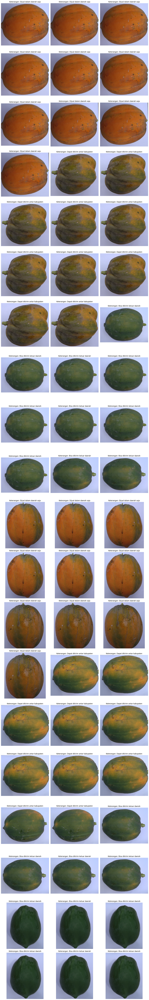

In [ ]:
# prompt: kemudian panggil gambar dengan filepath dan masukkan keterangannya apakah dijual diaerah, antar kabupaten , dan keluar daerah. dan untuk gambar tersebut digabung saja dalam frame yang kecil

# Mengambil data gambar dan keterangan dari DataFrame
filepaths = df_results['filepath'].tolist()
keterangans = df_results['Keterangan'].tolist()

# Menentukan jumlah baris dan kolom untuk grid gambar
num_cols = 3  # Jumlah kolom dalam grid
num_rows = (len(filepaths) + num_cols - 1) // num_cols  # Jumlah baris yang dibutuhkan

# Membuat figure dan axes untuk grid gambar
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))

# Iterasi melalui gambar dan keterangan, dan menampilkannya di grid
for i, (filepath, keterangan) in enumerate(zip(filepaths, keterangans)):
    row = i // num_cols
    col = i % num_cols
    ax = axes[row, col] if num_rows > 1 else axes[col]

    # Membaca gambar
    img = plt.imread(filepath)

    # Menampilkan gambar dan keterangan
    ax.imshow(img)
    ax.set_title(f"Keterangan: {keterangan}")
    ax.axis('off')

# Menyembunyikan axes yang tidak digunakan jika ada
if len(filepaths) < num_rows * num_cols:
    for i in range(len(filepaths), num_rows * num_cols):
        row = i // num_cols
        col = i % num_cols
        ax = axes[row, col] if num_rows > 1 else axes[col]
        ax.axis('off')

# Menampilkan plot
plt.tight_layout()
plt.show()


In [ ]:
# prompt: kemudian lakukan penghapusan outlier saja dari RGB sampai HSV
from scipy import stats

# Pilih kolom yang akan diperiksa outliernya
columns_to_check = ['Mean_R', 'Mean_G', 'Mean_B', 'Mean_H', 'Mean_S', 'Mean_V']

# Hitung z-score untuk setiap nilai dalam kolom yang dipilih
z_scores = np.abs(stats.zscore(df_results[columns_to_check]))

# Tentukan ambang batas untuk outlier (misalnya, 3 deviasi standar)
threshold = 3

# Temukan indeks baris dengan outlier
outlier_indices = np.where(z_scores > threshold)[0]

# Hapus outlier dari DataFrame
df_filtered = df_results.drop(outlier_indices)

# Tampilkan DataFrame yang telah difilter
print("DataFrame Setelah Penghapusan Outlier:")
display(df_filtered)


DataFrame Setelah Penghapusan Outlier:


,filepath,Mean_R,Mean_G,Mean_B,Mean_H,Mean_S,Mean_V,Prediction,Keterangan
0,Mature_001 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
1,Mature_002 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
2,Mature_003 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
3,Mature_004 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
4,Mature_005 (1).jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
5,Mature_006.jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
6,Mature_007.jpg,-1.236415,-0.873134,0.822575,1.545085,1.698511,0.572410,2.0,Dijual dalam daerah saja
7,Mature_008.jpg,-1.118528,-0.850539,0.771125,1.394745,1.613078,0.536106,2.0,Dijual dalam daerah saja
8,Mature_009.jpg,-1.118528,-0.850539,0.771125,1.394745,1.613078,0.536106,2.0,Dijual dalam daerah saja
9,Mature_010.jpg,-1.118528,-0.850539,0.771125,1.394745,1.613078,0.536106,2.0,Dijual dalam daerah saja


Variansi yang Dijelaskan oleh Setiap Komponen Utama:
[7.59648805e-01 2.01235602e-01 2.53161264e-02 1.33430425e-02
 4.46926888e-04 9.49750255e-06]


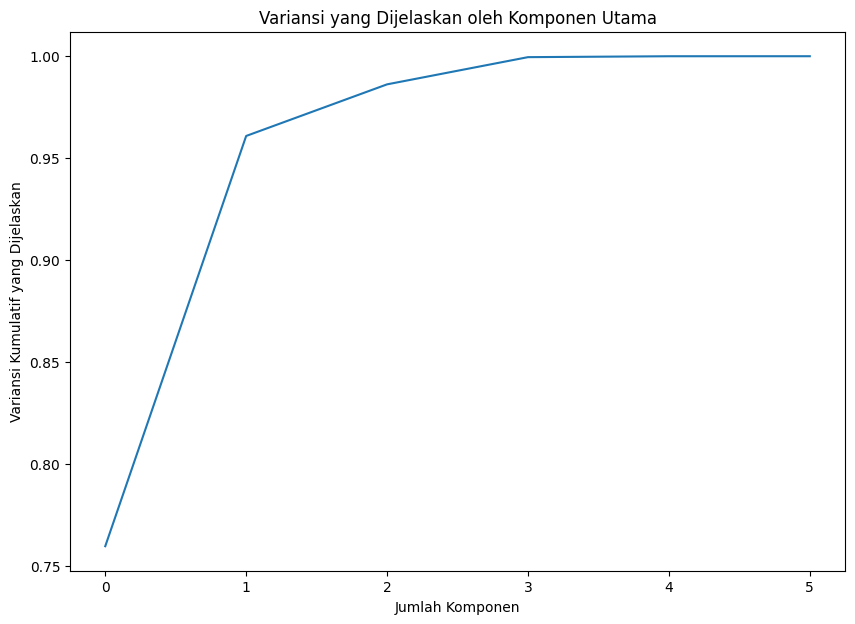

In [ ]:
# prompt: kemudian lakukan pca analisis terbaik

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Pilih kolom numerik yang akan digunakan dalam PCA
features = ['Mean_R', 'Mean_G', 'Mean_B', 'Mean_H', 'Mean_S', 'Mean_V']
x = df_filtered.loc[:, features].values

# Skala data
x = StandardScaler().fit_transform(x)

# Inisialisasi PCA dan fit ke data
pca = PCA()
principalComponents = pca.fit_transform(x)

# Buat DataFrame dari komponen utama
principalDf = pd.DataFrame(data = principalComponents)

# Tampilkan variansi yang dijelaskan oleh setiap komponen utama
print("Variansi yang Dijelaskan oleh Setiap Komponen Utama:")
print(pca.explained_variance_ratio_)

# Plot variansi yang dijelaskan oleh setiap komponen utama
plt.figure(figsize=(10, 7))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Jumlah Komponen')
plt.ylabel('Variansi Kumulatif yang Dijelaskan')
plt.title('Variansi yang Dijelaskan oleh Komponen Utama')
plt.show()


For n_clusters = 2, only one cluster was found. Skipping silhouette score calculation.
For n_clusters = 3, only one cluster was found. Skipping silhouette score calculation.
For n_clusters = 4, only one cluster was found. Skipping silhouette score calculation.
For n_clusters = 5, only one cluster was found. Skipping silhouette score calculation.
For n_clusters = 6, only one cluster was found. Skipping silhouette score calculation.
For n_clusters = 7, only one cluster was found. Skipping silhouette score calculation.
For n_clusters = 8, only one cluster was found. Skipping silhouette score calculation.
Untuk n_clusters = 9 Skor silhouette rata-rata adalah : 0.5891427460095239
Untuk n_clusters = 10 Skor silhouette rata-rata adalah : 0.7132796431382176


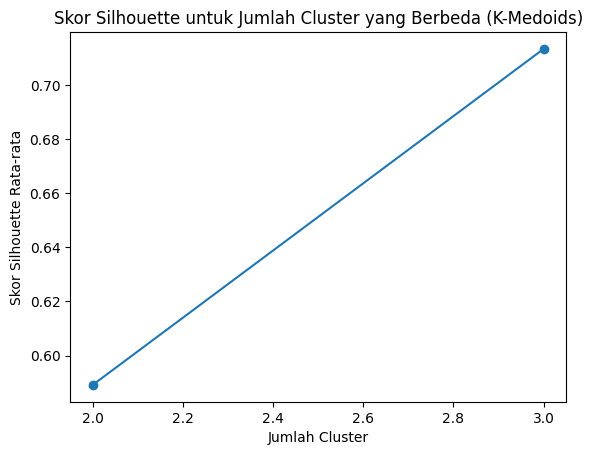


Jumlah cluster optimal berdasarkan skor silhouette (K-Medoids): 3


In [ ]:
from sklearn_extra.cluster import KMedoids
from sklearn.metrics import silhouette_score

# Range jumlah cluster yang akan diuji
range_n_clusters = range(2, 11)

# List untuk menyimpan skor silhouette
silhouette_scores = []

# Loop melalui jumlah cluster yang berbeda
for n_clusters in range_n_clusters:
    # Inisialisasi K-medoids clustering
    kmedoids = KMedoids(n_clusters=n_clusters, random_state=0)

    # Fit model ke data
    cluster_labels = kmedoids.fit_predict(principalDf)  # Menggunakan principalDf dari PCA

    # Periksa jumlah label unik. Jika hanya ada satu label, lewati perhitungan skor silhouette.
    if len(np.unique(cluster_labels)) > 1:
        # Hitung skor silhouette
        silhouette_avg = silhouette_score(principalDf, cluster_labels)
        silhouette_scores.append(silhouette_avg)

        print("Untuk n_clusters =", n_clusters, "Skor silhouette rata-rata adalah :", silhouette_avg)
    else:
        print(f"For n_clusters = {n_clusters}, only one cluster was found. Skipping silhouette score calculation.")

# Plot skor silhouette
plt.plot(range(2, len(silhouette_scores) + 2), silhouette_scores, marker='o') # Adjust x-axis to match the number of valid silhouette scores
plt.xlabel('Jumlah Cluster')
plt.ylabel('Skor Silhouette Rata-rata')
plt.title('Skor Silhouette untuk Jumlah Cluster yang Berbeda (K-Medoids)')
plt.show()

# Temukan jumlah cluster optimal berdasarkan skor silhouette tertinggi
if silhouette_scores: # Check if silhouette_scores is not empty
    optimal_n_clusters = range(2, len(silhouette_scores) + 2)[np.argmax(silhouette_scores)] # Adjust range to match the number of valid silhouette scores
    print("\nJumlah cluster optimal berdasarkan skor silhouette (K-Medoids):", optimal_n_clusters)
else:
    print("\nNo valid silhouette scores could be calculated.")

# __Garis bawahi untuk K-Medoids:__
# Jumlah cluster optimal untuk K-Medoids clustering adalah yang memberikan skor silhouette tertinggi.
# Dalam kasus ini, Anda perlu memeriksa plot atau nilai dalam `silhouette_scores` untuk menentukan jumlah cluster optimal.

In [ ]:
# prompt: kemudian lakukan inisialisasi Medoid++ yang terbaik

# Inisialisasi K-medoids clustering dengan Medoid++ dan jumlah cluster optimal
kmedoids = KMedoids(n_clusters=optimal_n_clusters, init='k-medoids++', random_state=0)

# Fit model ke data
cluster_labels = kmedoids.fit_predict(principalDf)  # Menggunakan principalDf dari PCA

# Tampilkan label cluster
print("Label Cluster:")
print(cluster_labels)


Label Cluster:
[1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 2 2 2 2 2 2 2 2 2 2 1 1 1 1 1 1 0
 0 0 0 0 0 0 0 0 0 0 0 2 2 2 2 2 2 2 2 2 2 2 2]


In [ ]:
# prompt: kemudian lakukan penggunaan Dissimilarity Matrix

from sklearn.metrics.pairwise import pairwise_distances
# Hitung Dissimilarity Matrix
dissimilarity_matrix = pairwise_distances(principalDf, metric='euclidean')

# Inisialisasi K-medoids clustering dengan Dissimilarity Matrix dan jumlah cluster optimal
kmedoids = KMedoids(n_clusters=optimal_n_clusters, metric='precomputed', random_state=0)

# Fit model ke Dissimilarity Matrix
cluster_labels_dissimilarity = kmedoids.fit_predict(dissimilarity_matrix)

# Tampilkan label cluster yang diperoleh menggunakan Dissimilarity Matrix
print("\nLabel Cluster (menggunakan Dissimilarity Matrix):")
print(cluster_labels_dissimilarity)



Label Cluster (menggunakan Dissimilarity Matrix):
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


In [ ]:
# prompt: kemudian lakukan iterasi maksimum

# Inisialisasi K-medoids clustering dengan jumlah cluster optimal dan iterasi maksimum
kmedoids = KMedoids(n_clusters=optimal_n_clusters, init='k-medoids++', random_state=0, max_iter=1000)  # Ganti 1000 dengan jumlah iterasi maksimum yang diinginkan

# Fit model ke data
cluster_labels = kmedoids.fit_predict(principalDf)  # Menggunakan principalDf dari PCA

# Tampilkan label cluster
print("Label Cluster (dengan iterasi maksimum):")
print(cluster_labels)


Label Cluster (dengan iterasi maksimum):
[1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 2 2 2 2 2 2 2 2 2 2 1 1 1 1 1 1 0
 0 0 0 0 0 0 0 0 0 0 0 2 2 2 2 2 2 2 2 2 2 2 2]


In [ ]:
# prompt: kemudian lakukan evaluasi

from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Hitung skor Silhouette
silhouette_avg = silhouette_score(principalDf, cluster_labels)
print("Skor Silhouette:", silhouette_avg)

# Hitung skor Calinski-Harabasz
calinski_harabasz_score_value = calinski_harabasz_score(principalDf, cluster_labels)
print("Skor Calinski-Harabasz:", calinski_harabasz_score_value)

# Hitung skor Davies-Bouldin
davies_bouldin_score_value = davies_bouldin_score(principalDf, cluster_labels)
print("Skor Davies-Bouldin:", davies_bouldin_score_value)


Skor Silhouette: 0.5891427460095239
Skor Calinski-Harabasz: 90.84230767098504
Skor Davies-Bouldin: 0.7892680888068931


In [ ]:
# prompt: kemudian lakukan validasi pada k medoids dan buat kesimpulannya. jika dibawah 0,5 maka algoritmanya jelek, diatas 0,5 sampai 0,71 artinya cukup bagus, dan diatas 0,71 sampai 1 artiya sangat bagus. kecuali diatas 1 artinya jelek sekali dan buat kesimpulannya beserta nilai silhouettenya

# Validasi K-Medoids
if silhouette_avg < 0.5:
    print(f"Silhouette Score: {silhouette_avg:.2f} - Algoritma K-Medoids memiliki kinerja yang buruk.")
elif silhouette_avg < 0.71:
    print(f"Silhouette Score: {silhouette_avg:.2f} - Algoritma K-Medoids memiliki kinerja yang cukup bagus.")
elif silhouette_avg <= 1:
    print(f"Silhouette Score: {silhouette_avg:.2f} - Algoritma K-Medoids memiliki kinerja yang sangat bagus.")
else:
    print(f"Silhouette Score: {silhouette_avg:.2f} - Algoritma K-Medoids memiliki kinerja yang buruk sekali (nilai di atas 1 tidak valid).")

# Kesimpulan
print("\nKesimpulan:")
print(f"Berdasarkan Silhouette Score sebesar {silhouette_avg:.2f}, dapat disimpulkan bahwa algoritma K-Medoids yang digunakan untuk clustering pada dataset ini memiliki kinerja {'buruk' if silhouette_avg < 0.5 else ('cukup bagus' if silhouette_avg < 0.71 else ('sangat bagus' if silhouette_avg <= 1 else 'buruk sekali (nilai di atas 1 tidak valid)'))}.")


Silhouette Score: 0.59 - Algoritma K-Medoids memiliki kinerja yang cukup bagus.

Kesimpulan:
Berdasarkan Silhouette Score sebesar 0.59, dapat disimpulkan bahwa algoritma K-Medoids yang digunakan untuk clustering pada dataset ini memiliki kinerja cukup bagus.


In [ ]:
# prompt: kemudian tampilkan plot clusteringnya. yang terdiri dari 3 clustering secara interaktif dan mudah dipahami

import plotly.express as px

# Assuming 'principalDf' is the DataFrame from PCA and 'cluster_labels' are the cluster assignments
principalDf['Cluster'] = cluster_labels

# Create an interactive 3D scatter plot
fig = px.scatter_3d(principalDf, x=0, y=1, z=2, color='Cluster',
                    title='Visualisasi Cluster dalam 3D',
                    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3', 'Cluster': 'Cluster'})

fig.show()


In [ ]:
# prompt: kemudian tampilkan list cluster 0, 1, dan 2

# Menampilkan daftar anggota setiap cluster
for cluster_id in range(optimal_n_clusters):
    cluster_members = principalDf[principalDf['Cluster'] == cluster_id]
    print(f"\nAnggota Cluster {cluster_id}:")
    print(cluster_members)



Anggota Cluster 0:
           0         1         2         3         4         5  Cluster
10 -0.192408 -0.173124  0.603268 -0.307177 -0.039953 -0.004778        0
11 -0.192408 -0.173124  0.603268 -0.307177 -0.039953 -0.004778        0
12 -0.192408 -0.173124  0.603268 -0.307177 -0.039953 -0.004778        0
13 -0.192408 -0.173124  0.603268 -0.307177 -0.039953 -0.004778        0
14 -0.192408 -0.173124  0.603268 -0.307177 -0.039953 -0.004778        0
15 -0.192408 -0.173124  0.603268 -0.307177 -0.039953 -0.004778        0
16 -0.192408 -0.173124  0.603268 -0.307177 -0.039953 -0.004778        0
17 -0.192408 -0.173124  0.603268 -0.307177 -0.039953 -0.004778        0
18 -0.117576 -0.095475  0.663463 -0.248037 -0.060370 -0.003522        0
19 -0.117576 -0.095475  0.663463 -0.248037 -0.060370 -0.003522        0
36  1.084819  1.349877  0.714618  0.072362  0.111247  0.009344        0
37  1.084819  1.349877  0.714618  0.072362  0.111247  0.009344        0
38  1.084819  1.349877  0.714618  0.072362  


Cluster 0:


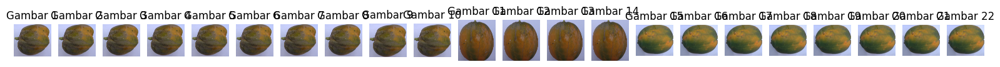


Cluster 1:


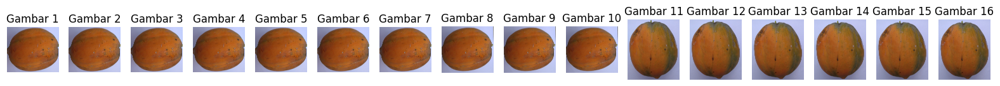


Cluster 2:


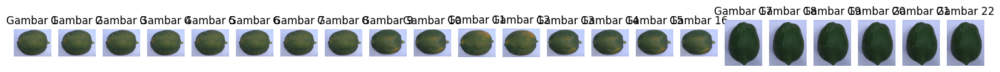

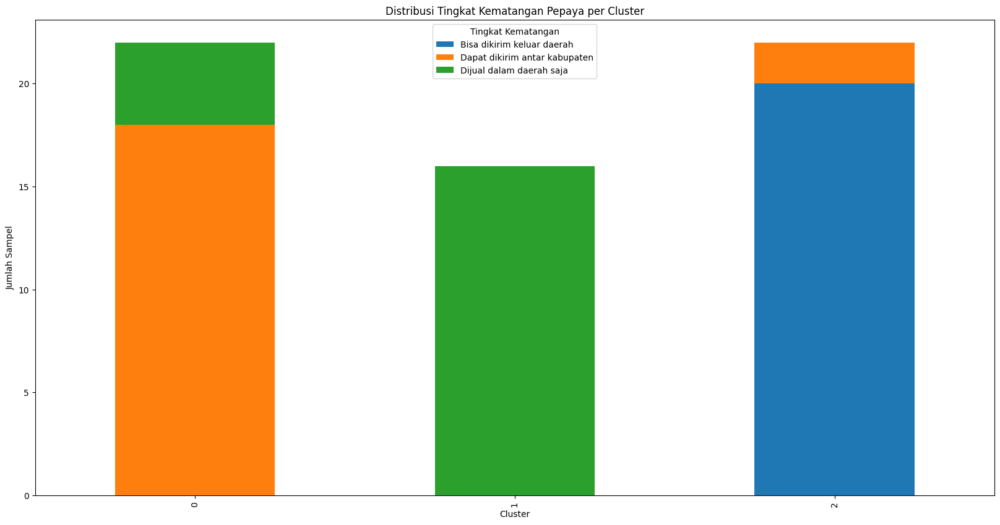


Cluster 0:
  - Tingkat kematangan paling sering: Dapat dikirim antar kabupaten

Cluster 1:
  - Tingkat kematangan paling sering: Dijual dalam daerah saja

Cluster 2:
  - Tingkat kematangan paling sering: Bisa dikirim keluar daerah


In [ ]:
# Membuat dictionary untuk mengelompokkan gambar berdasarkan cluster
cluster_images = {i: [] for i in range(optimal_n_clusters)}

# Mengelompokkan gambar berdasarkan cluster
for index, row in principalDf.iterrows(): # Changed df_filtered to principalDf
    filepath = df_filtered.iloc[index]['filepath'] # Access filepath from df_filtered using index
    cluster = row['Cluster']
    cluster_images[cluster].append(filepath)

# Menampilkan gambar untuk setiap cluster
for cluster_id, image_paths in cluster_images.items():
    print(f"\nCluster {cluster_id}:")
    fig, axes = plt.subplots(1, len(image_paths), figsize=(20, 10))
    for i, image_path in enumerate(image_paths):
        img = plt.imread(image_path)
        ax = axes[i]
        ax.imshow(img)
        ax.set_title(f"Gambar {i+1}")
        ax.axis('off')
    plt.show()

# Hitung jumlah sampel di setiap cluster dan tingkat kematangan
cluster_counts = principalDf['Cluster'].value_counts() # Changed df_filtered to principalDf

# ----> The original code was grouping by 'Keterangan' and counting 'filepath'.
# ----> It needs to be grouped by cluster and count 'Keterangan'
maturity_counts = df_filtered.groupby(principalDf['Cluster'])['Keterangan'].value_counts()

# Buat diagram batang
fig, ax = plt.subplots(figsize=(20, 10))

# ----> maturity_counts needs to be unstacked to create a bar plot.
maturity_counts.unstack().plot(kind='bar', stacked=True, ax=ax)

ax.set_xlabel('Cluster')
ax.set_ylabel('Jumlah Sampel')
ax.set_title('Distribusi Tingkat Kematangan Pepaya per Cluster')
ax.legend(title='Tingkat Kematangan')

plt.show()

# Kesimpulan berdasarkan tingkat kematangan pepaya
# ----> Iterate over the cluster indices found in maturity_counts
for cluster_id in maturity_counts.index.levels[0]:
    print(f"\nCluster {cluster_id}:")

    # ----> Access data using the multiindex
    cluster_data = maturity_counts[cluster_id]

    most_frequent_maturity = cluster_data.idxmax()
    print(f"  - Tingkat kematangan paling sering: {most_frequent_maturity}")